<a href="https://colab.research.google.com/github/bwsi-hadr/2019-student-final-exercise/blob/master/Planning_Hayden_Maps_Final_exercise_grid.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
# need to specify location of some certificates for rasterio
!export CURL_CA_BUNDLE=/etc/ssl/certs/ca-certificates.crt
!sudo mkdir -p /etc/pki/tls/certs
!sudo cp /etc/ssl/certs/ca-certificates.crt /etc/pki/tls/certs/ca-bundle.crt
try:
  import rasterio
  import rasterio.plot
  import rasterio.merge 
  import rasterio.mask
except:
  !pip install rasterio
  import rasterio
  import rasterio.plot
  import rasterio.merge
  import rasterio.mask
  
try:
  import rasterstats as rs
except:
  !pip install rasterstats  
  import rasterstats as rs
  
try:
  import pyproj
except:
  !pip install pyproj
  import pyproj
  
import networkx as nx
try:
  import osmnx as ox
except:
  # osmnx depends on the system package libspatialindex
  !apt install libspatialindex-dev
  !pip install osmnx
  import osmnx as ox

try: 
  import geopandas as gpd
except: 
  !pip install geopandas 
  import geopandas as gpd
  
try:
  import contextily as ctx 
except:
  # install dependencies for contextily
  !apt install libproj-dev proj-data proj-bin
  !apt install libgeos-dev
  !pip install cython
  !pip install cartopy
  # install contextily
  !pip install contextily==1.0rc1 --no-use-pep517 --no-cache-dir
  import contextily as ctx
  
import fiona
from shapely.geometry import Point, LineString, Polygon
  
import gdal
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pathlib
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/'My Drive'/BWSI-Remote-Sensing/'Final_exercise'

     |████████████████████████████████| 19.7MB 4.3MB/s 
     |████████████████████████████████| 17.9MB 7.2MB/s 
     |████████████████████████████████| 81kB 24.3MB/s 
  Created wheel for simplejson: filename=simplejson-3.16.0-cp36-cp36m-linux_x86_64.whl size=114017 sha256=2438dda6688d3e3d7470496a1dfc4d3eab38d5da535ba21ff0e49b88fe34231b
  Stored in directory: /root/.cache/pip/wheels/5d/1a/1e/0350bb3df3e74215cd91325344cc86c2c691f5306eb4d22c77
  Created wheel for munch: filename=munch-2.3.2-py2.py3-none-any.whl size=6613 sha256=c414fea3da2a4bd9ee43132aa8a72cdc9434c49433c94ec185306f5e40a2fc21
  Stored in directory: /root/.cache/pip/wheels/db/bf/bc/06a3e1bfe0ab27d2e720ceb3cff3159398d92644c0cec2c125
Successfully built simplejson munch
     |████████████████████████████████| 11.2MB 4.8MB/s 
Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-410
Use 'apt 

In [3]:
!ls game_grid_export
!ls game2

facilities	      flooding.prj	       game_grid_all_stats.dbf
facilities_stats.csv  flooding.shp	       game_grid_all_stats.prj
flooding.cpg	      flooding.shx	       game_grid_all_stats.shp
flooding.dbf	      game_grid_all_stats.cpg  game_grid_all_stats.shx
prep_turn_0  prep_turn_1  resources.csv


In [0]:
turn=1
original_grid=gpd.read_file('game_grid_export/game_grid_all_stats.shp')
game_grid=gpd.read_file('game2/response_turn_{}/curr_grid.shp'.format(turn))
#game_grid

In [0]:
#original_grid=gpd.read_file('/content/original_grid.shp')
change=game_grid.copy()
change['Health']=game_grid['Health']-original_grid['Health']
change['Utility']=game_grid['Utility']-original_grid['Utility']
change['Transporta']=game_grid['Transporta']-original_grid['Transporta']

In [6]:
game_grid

,Health,Utility,Transporta,geometry
0,10,7,8,POLYGON ((-71.79092278136125 42.58943590354409...
1,10,7,8,POLYGON ((-71.77874932612048 42.58973201162303...
2,10,7,8,POLYGON ((-71.76657568741803 42.59002682737616...
3,10,7,3,POLYGON ((-71.75440186615322 42.59032035170287...
4,10,7,3,POLYGON ((-71.74222786322531 42.59061258370377...
5,10,7,3,POLYGON ((-71.73005367863436 42.59090352427819...
6,10,7,3,POLYGON ((-71.71787931507833 42.59119317252686...
7,10,7,3,POLYGON ((-71.70570477165785 42.59148152844978...
8,10,7,3,POLYGON ((-71.69353005017166 42.59176859294621...
9,10,7,3,POLYGON ((-71.68135515061971 42.59205436511684...


In [124]:
game_grid.loc[game_grid['Health']<7]

,Health,Utility,Transporta,geometry
0,5,10,5,POLYGON ((-71.79092278136125 42.58943590354409...
1,1,10,4,POLYGON ((-71.77874932612048 42.58973201162303...
2,1,10,1,POLYGON ((-71.76657568741803 42.59002682737616...
3,5,10,1,POLYGON ((-71.75440186615322 42.59032035170287...
4,4,10,1,POLYGON ((-71.74222786322531 42.59061258370377...
5,4,10,1,POLYGON ((-71.73005367863436 42.59090352427819...
6,5,10,1,POLYGON ((-71.71787931507833 42.59119317252686...
7,5,8,1,POLYGON ((-71.70570477165785 42.59148152844978...
8,6,10,1,POLYGON ((-71.69353005017166 42.59176859294621...
9,4,10,1,POLYGON ((-71.68135515061971 42.59205436511684...


In [0]:
flooding=gpd.read_file('game_grid_export/flooding.shp')

#Health

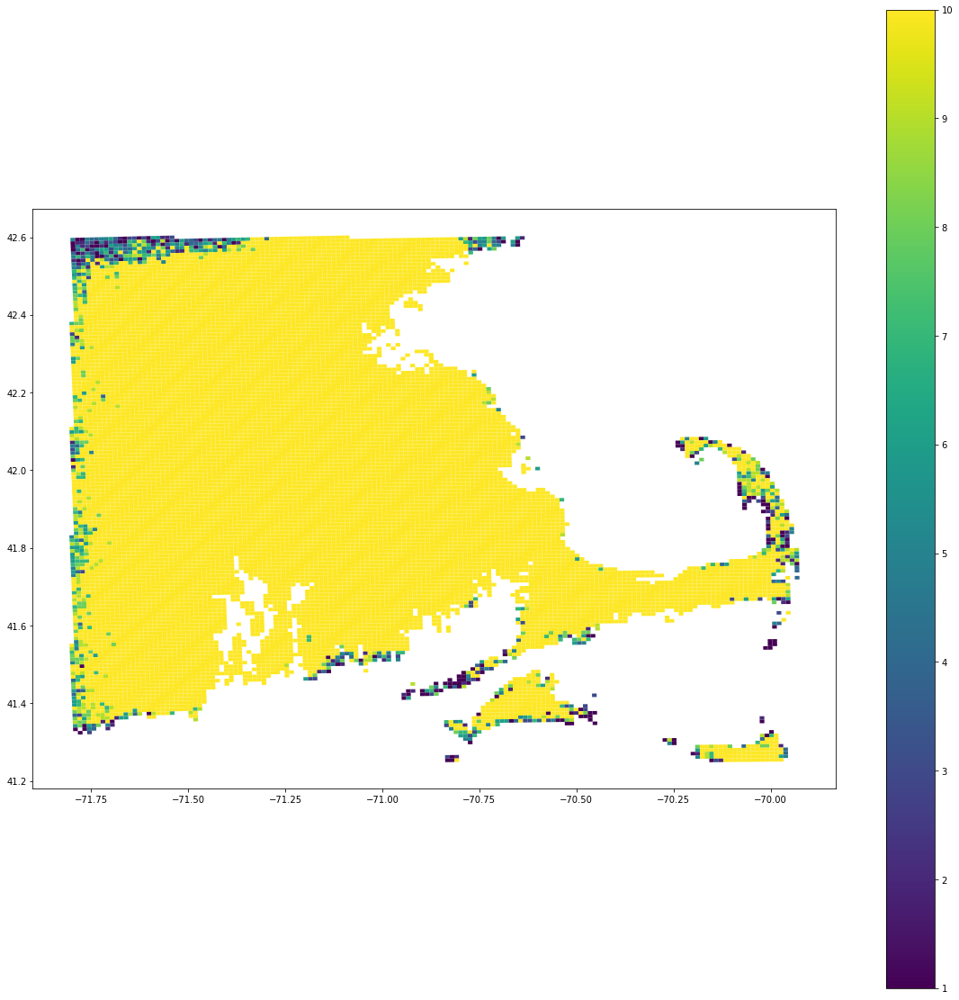

In [122]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Health', legend=True)

#Amount of People Dying
Can't account for evacuated/saved people

Don't use the data in areas that have been saved

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value inst

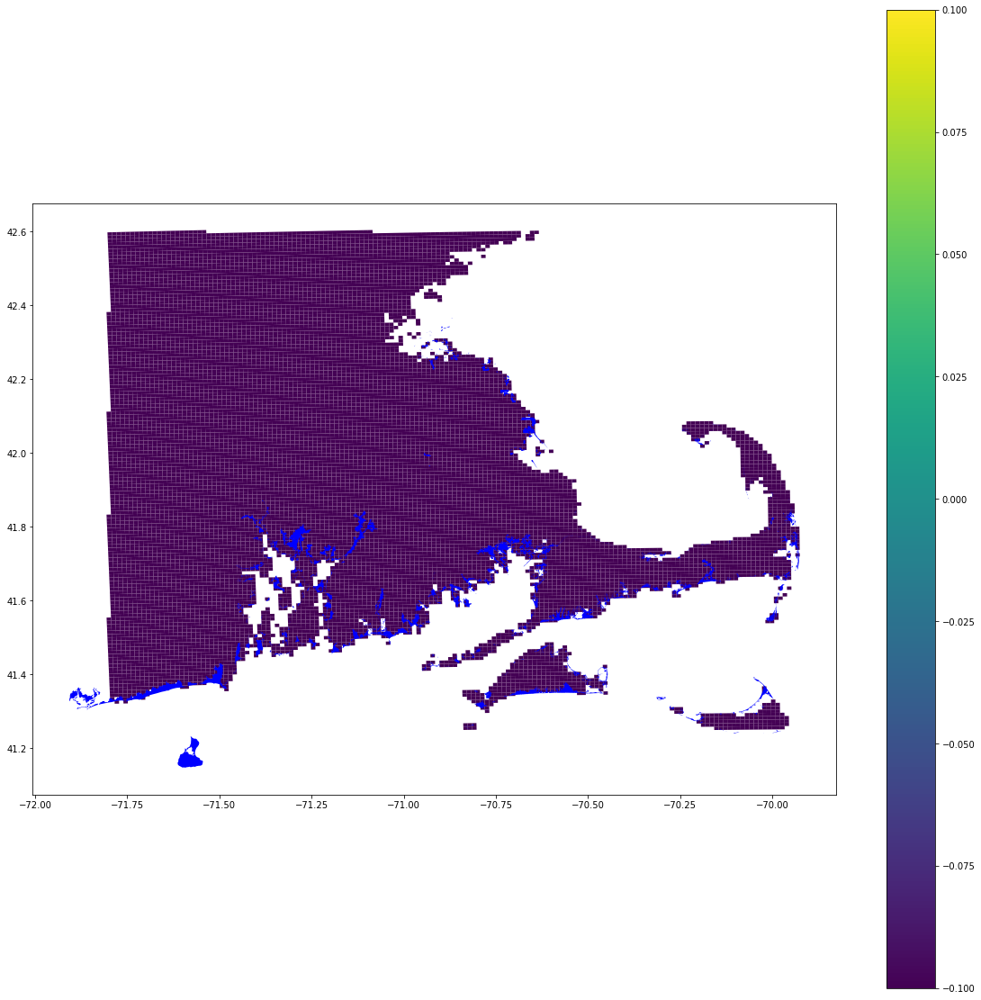

In [125]:
danger_grid=game_grid.copy()
danger_grid['danger']=0
danger_grid.loc[danger_grid['Health']>=9]['danger']=0
danger_grid.loc[danger_grid['Health']<9]['danger']=.0025
danger_grid.loc[danger_grid['Health']<7]['danger']=.005
danger_grid['danger']=original_grid['population']*danger_grid['danger']
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
danger_grid.plot(ax=ax, column='danger', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

In [0]:
#danger_grid

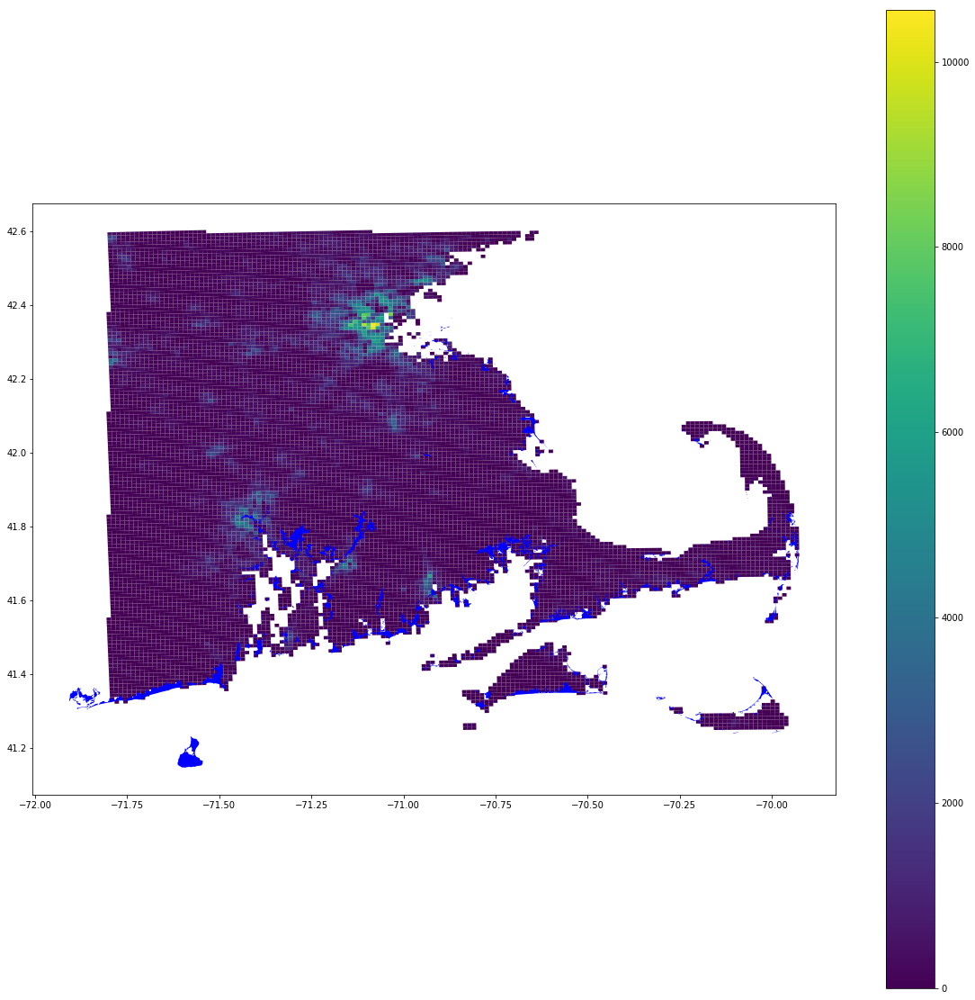

In [12]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
original_grid.plot(ax=ax, column='population', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

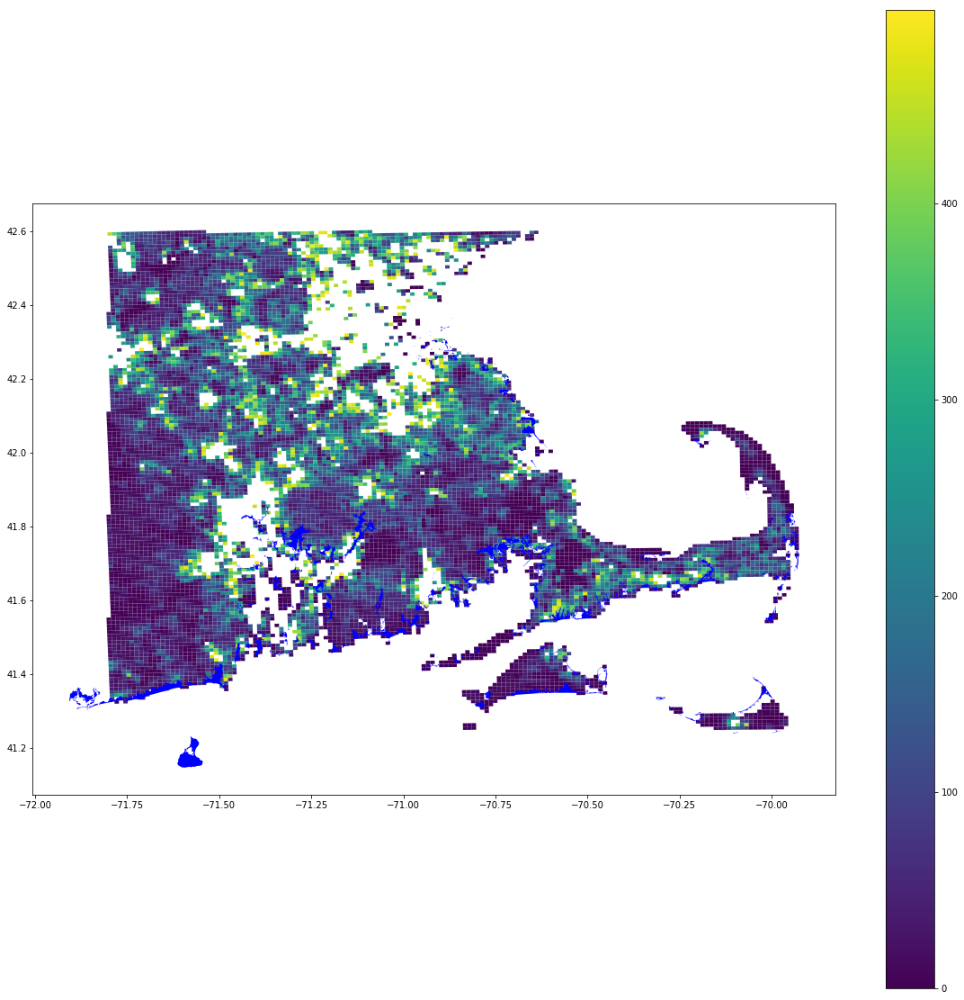

In [13]:
low_pop=original_grid.loc[original_grid['population']<500]
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
low_pop.plot(ax=ax, column='population', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

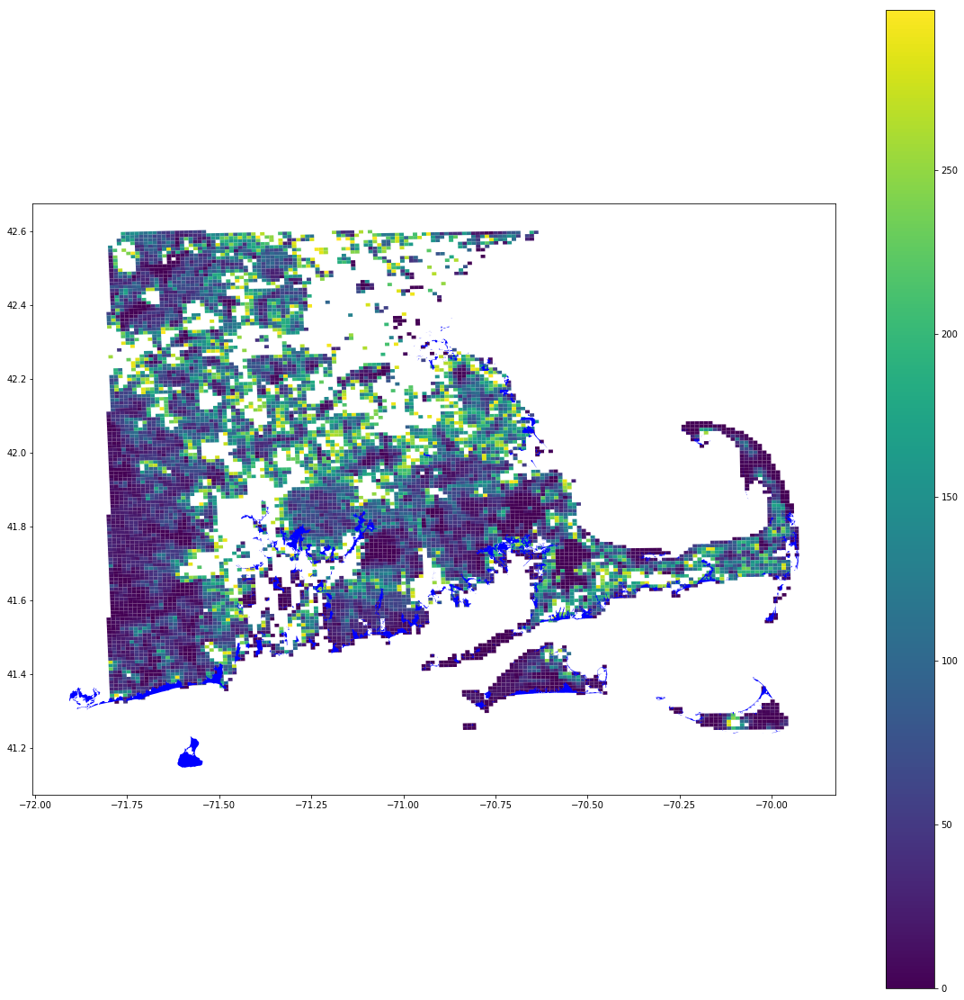

In [14]:
low_pop=original_grid.loc[original_grid['population']<300]
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
low_pop.plot(ax=ax, column='population', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

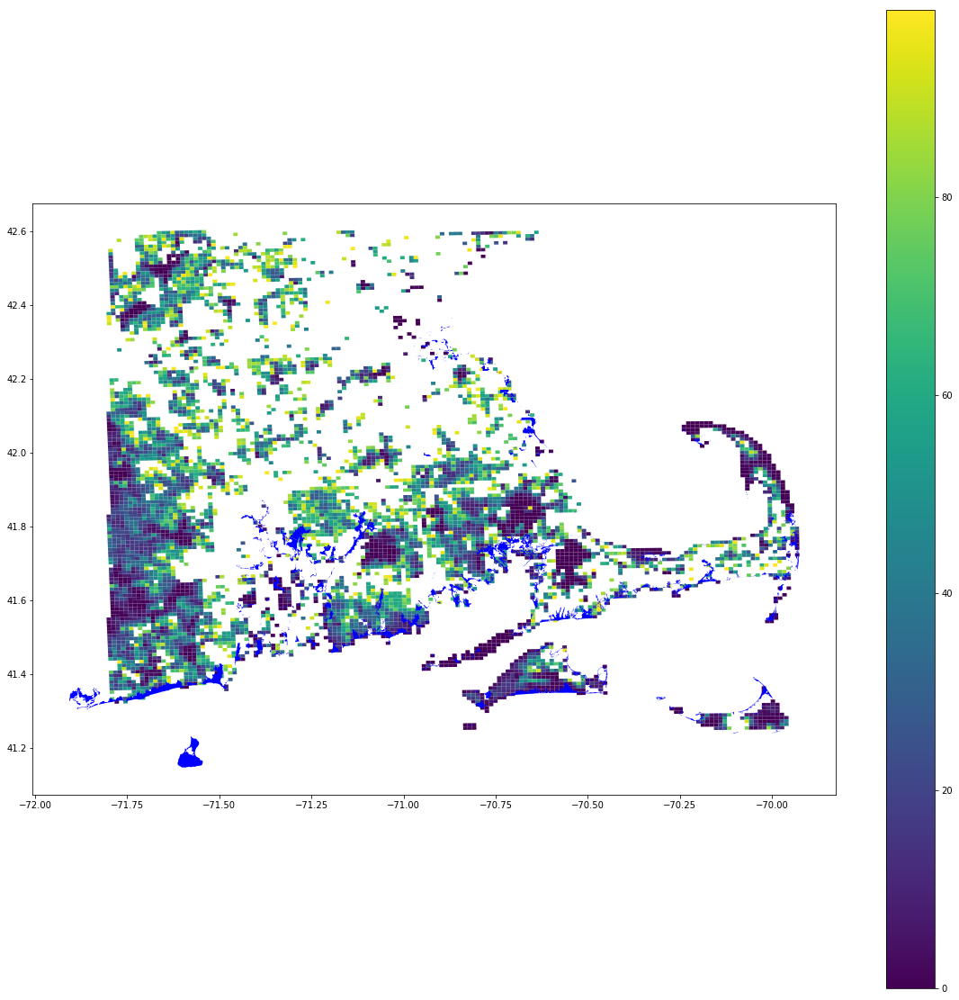

In [15]:
low_pop=original_grid.loc[original_grid['population']<100]
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
low_pop.plot(ax=ax, column='population', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

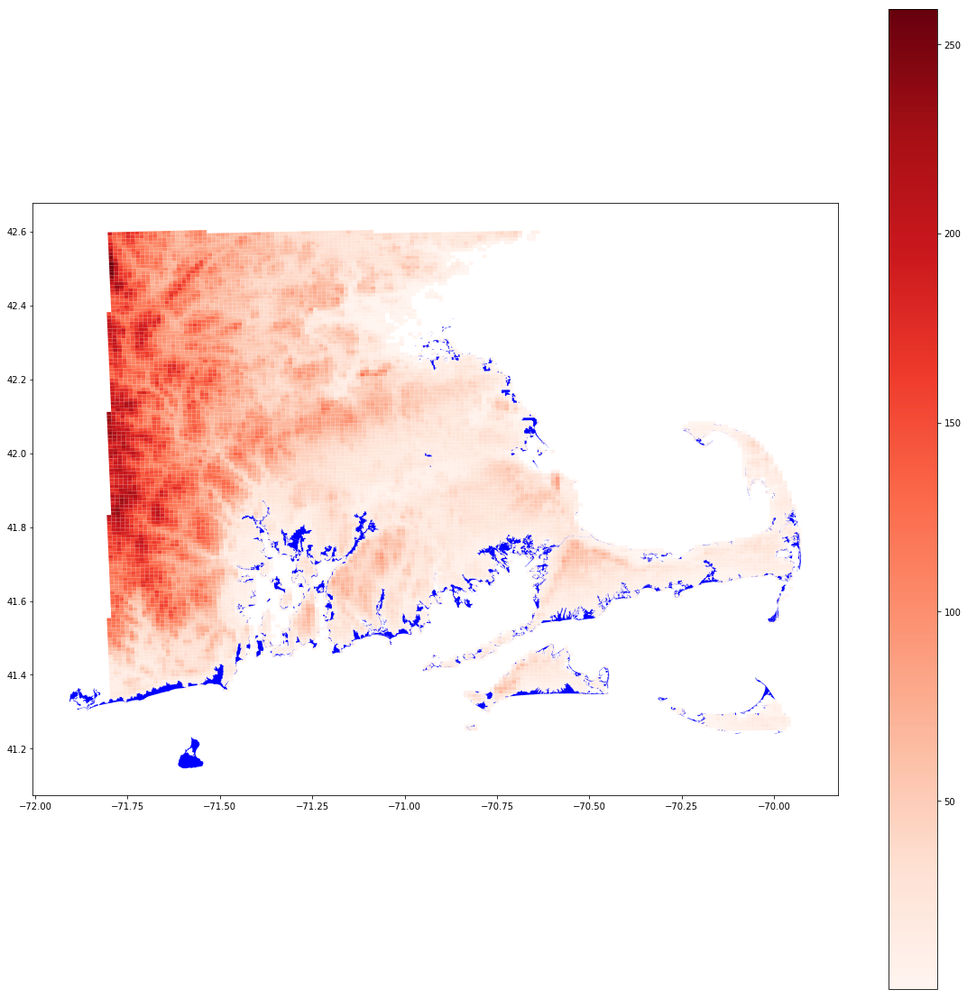

In [16]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
original_grid.plot(ax=ax, column='elevation', legend=True, cmap='Reds')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

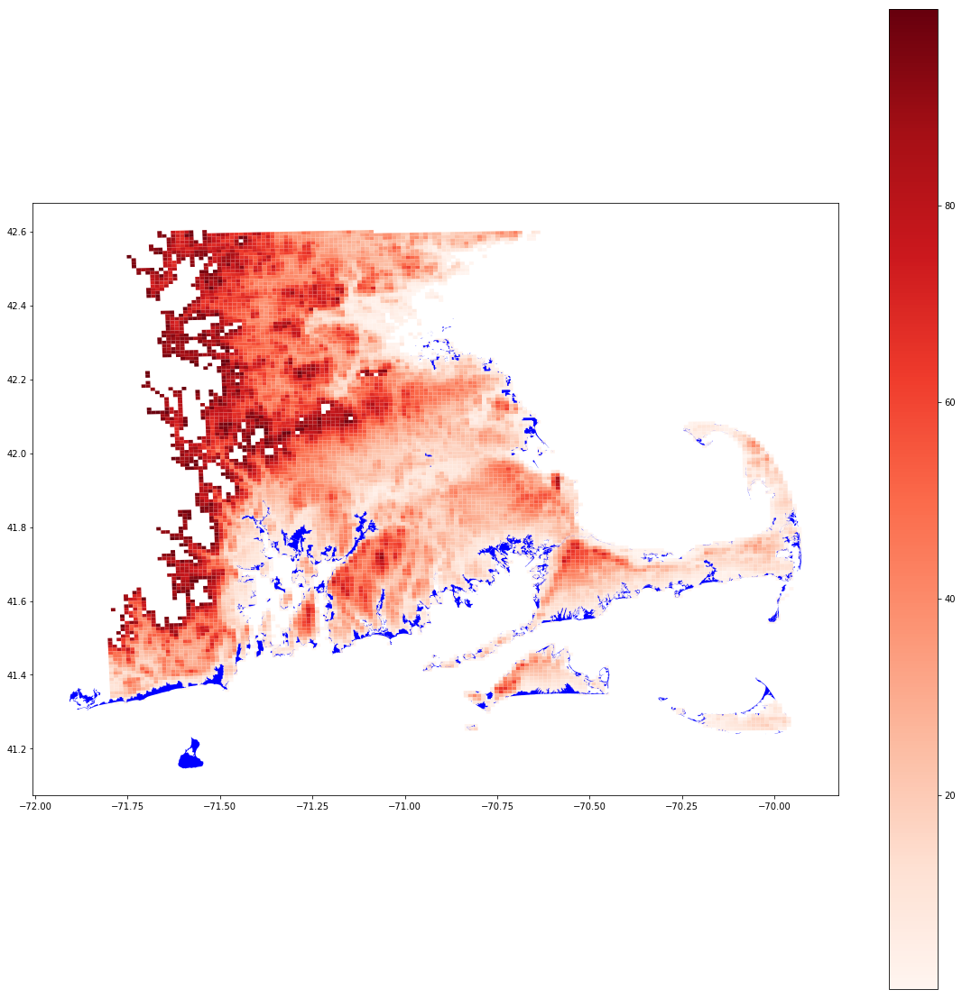

In [17]:
low=original_grid.loc[original_grid['elevation']<100]
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
low.plot(ax=ax, column='elevation', legend=True, cmap='Reds')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)

In [0]:
status=gpd.read_file('game2/prep_turn_{}/facilities_status.shp'.format(turn))

In [0]:
status

#Downloads for Colab

In [0]:
hospitals=gpd.read_file('game_grid_export/facilities/hospitals.shp')
shelters=gpd.read_file('game_grid_export/facilities/shelters.shp')
plants=gpd.read_file('game_grid_export/facilities/powerplants.shp')
towers=gpd.read_file('game_grid_export/facilities/cell_towers.shp')
stations=gpd.read_file('game_grid_export/facilities/fire_stations.shp')
local_eo=gpd.read_file('game_grid_export/facilities/local_eocs.shp')
state_eo=gpd.read_file('game_grid_export/facilities/state_eocs.shp')
big_hospitals=hospitals[hospitals['BEDS']>=200]
small_hospitals=hospitals[hospitals['BEDS']<200]
EMS=gpd.read_file('game_grid_export/facilities/EMS.shp')
big_EMS=EMS[EMS['TOTAL_VEHI']>=5]
small_EMS=EMS[EMS['TOTAL_VEHI']<5]
change=game_grid.copy()
change['Health']=game_grid['Health']-original_grid['Health']
change['Utility']=game_grid['Utility']-original_grid['Utility']
change['Transporta']=game_grid['Transporta']-original_grid['Transporta']
airfields=gpd.read_file('game_grid_export/facilities/airfields.shp')

In [0]:
big_hospitals_data=gpd.sjoin(big_hospitals, game_grid)
#big_hospitals_data=gpd.sjoin(big_hospitals, game_grid)
eff_big_hospitals=big_hospitals_data[big_hospitals_data['Utility']>=8]
dead_big_hospitals=big_hospitals_data[big_hospitals_data['Utility']<8]
small_hospitals_data=gpd.sjoin(small_hospitals, game_grid)
eff_small_hospitals=small_hospitals_data[small_hospitals_data['Utility']>=7]
dead_small_hospitals=small_hospitals_data[small_hospitals_data['Utility']<7]
big_EMS_data=gpd.sjoin(big_EMS, game_grid)
eff_big_EMS=big_EMS_data[big_EMS_data['Utility']>=6]
dead_big_EMS=big_EMS_data[big_EMS_data['Utility']<6]
small_EMS_data=gpd.sjoin(small_EMS, game_grid)
eff_small_EMS=small_EMS_data[small_EMS_data['Utility']>=6]
dead_small_EMS=small_EMS_data[small_EMS_data['Utility']<6]
plants_data=gpd.sjoin(plants, game_grid)
eff_plants=plants_data[plants_data['Utility']>=3]
dead_plants=plants_data[plants_data['Utility']<3]
stations_data=gpd.sjoin(stations, game_grid)
eff_stations=stations_data[stations_data['Utility']>=7]
dead_stations=stations_data[stations_data['Utility']<7]
towers_data=gpd.sjoin(towers, game_grid)
eff_towers=towers_data[towers_data['Utility']>=8]
dead_towers=towers_data[towers_data['Utility']<8]
shelters_data=gpd.sjoin(shelters, game_grid)
eff_shelters=shelters_data[shelters_data['Utility']>=3]
dead_shelters=shelters_data[shelters_data['Utility']<3]
airfields_data=gpd.sjoin(airfields, game_grid)
eff_airfields=airfields_data[airfields_data['Utility']>=6]
dead_airfields=airfields_data[airfields_data['Utility']<6]
lcl_eo_data=gpd.sjoin(local_eo, game_grid)
eff_lcl_eo=lcl_eo_data[lcl_eo_data['Utility']>=6]
dead_lcl_eo=lcl_eo_data[lcl_eo_data['Utility']<6]
stt_eo_data=gpd.sjoin(state_eo, game_grid)
eff_stt_eo=stt_eo_data[stt_eo_data['Utility']>=7]
dead_stt_eo=stt_eo_data[stt_eo_data['Utility']<7]

In [0]:
big_hospitals_data2=gpd.sjoin(big_hospitals, status.loc[status['type']=='hospital_l'])
ws_big_hospitals=big_hospitals_data2[np.logical_and(big_hospitals_data2['food_water']>=100, big_hospitals_data2['medicine']>=100)]
oos_big_hospitals=big_hospitals_data2[np.logical_or(big_hospitals_data2['food_water']<100, big_hospitals_data2['medicine']<100)]
small_hospitals_data2=gpd.sjoin(small_hospitals, status.loc[status['type']=='hospital_s'])
ws_small_hospitals=small_hospitals_data2[np.logical_and(small_hospitals_data2['food_water']>=50, small_hospitals_data2['medicine']>=50)]
oos_small_hospitals=small_hospitals_data2[np.logical_and(small_hospitals_data2['food_water']<50, small_hospitals_data2['medicine']<50)]
big_EMS_data2=gpd.sjoin(big_EMS, status.loc[status['type']=='ems_l'])
ws_big_EMS=big_EMS_data2[big_EMS_data2['medicine']>=50]
oos_big_EMS=big_EMS_data2[big_EMS_data2['medicine']<50]
small_EMS_data2=gpd.sjoin(small_EMS, status.loc[status['type']=='ems_s'])
ws_small_EMS=small_EMS_data2[small_EMS_data2['medicine']>=25]
oos_small_EMS=small_EMS_data2[small_EMS_data2['medicine']<25]
plants_data2=gpd.sjoin(plants, status.loc[status['type']=='power_plant'])
ws_plants=plants_data2[plants_data2['fuel']>=100]
oos_plants=plants_data2[plants_data2['fuel']<100]
shelters_data2=gpd.sjoin(shelters, status.loc[status['type']=='shelter'])
ws_shelters=shelters_data2[shelters_data2['food_water']>=100]
oos_shelters=shelters_data2[shelters_data2['food_water']<100]
airfields_data2=gpd.sjoin(airfields, status.loc[status['type']=='helipad'])
ws_airfields=airfields_data2[airfields_data2['fuel']>=30]
oos_airfields=airfields_data2[airfields_data2['fuel']<30]

In [152]:
big_hospitals_data2
del big_hospitals_data2[]
#big_hospitals_data=gpd.sjoin(big_hospitals_data2, game_grid)
#big_hospitals_data=gpd.sjoin(big_hospitals, game_grid)
#eff_big_hospitals=big_hospitals_data[big_hospitals_data['Utility']>=8]
#dead_big_hospitals=big_hospitals_data[big_hospitals_data['Utility']<8]
#small_hospitals_data=gpd.sjoin(small_hospitals, game_grid)
#eff_small_hospitals=small_hospitals_data[small_hospitals_data['Utility']>=7]
#dead_small_hospitals=small_hospitals_data[small_hospitals_data['Utility']<7]
#big_EMS_data=gpd.sjoin(big_EMS, game_grid)
#eff_big_EMS=big_EMS_data[big_EMS_data['Utility']>=6]
#dead_big_EMS=big_EMS_data[big_EMS_data['Utility']<6]
#small_EMS_data=gpd.sjoin(small_EMS, game_grid)
#eff_small_EMS=small_EMS_data[small_EMS_data['Utility']>=6]
#dead_small_EMS=small_EMS_data[small_EMS_data['Utility']<6]
#plants_data=gpd.sjoin(plants, game_grid)
#eff_plants=plants_data[plants_data['Utility']>=3]
#dead_plants=plants_data[plants_data['Utility']<3]
#stations_data=gpd.sjoin(stations, game_grid)
#eff_stations=stations_data[stations_data['Utility']>=7]
#dead_stations=stations_data[stations_data['Utility']<7]
#towers_data=gpd.sjoin(towers, game_grid)
#eff_towers=towers_data[towers_data['Utility']>=8]
#dead_towers=towers_data[towers_data['Utility']<8]
#shelters_data=gpd.sjoin(shelters, game_grid)
#eff_shelters=shelters_data[shelters_data['Utility']>=3]
#dead_shelters=shelters_data[shelters_data['Utility']<3]
#airfields_data=gpd.sjoin(airfields, game_grid)
#eff_airfields=airfields_data[airfields_data['Utility']>=6]
#dead_airfields=airfields_data[airfields_data['Utility']<6]
#lcl_eo_data=gpd.sjoin(local_eo, game_grid)
#eff_lcl_eo=lcl_eo_data[lcl_eo_data['Utility']>=6]
#dead_lcl_eo=lcl_eo_data[lcl_eo_data['Utility']<6]
#stt_eo_data=gpd.sjoin(state_eo, game_grid)
#eff_stt_eo=stt_eo_data[stt_eo_data['Utility']>=7]
#dead_stt_eo=stt_eo_data[stt_eo_data['Utility']<7]

,OBJECTID,ID,NAME,ADDRESS,CITY,STATE,ZIP,TYPE,STATUS,COUNTY,COUNTYFIPS,COUNTRY,LATITUDE,LONGITUDE,NAICS_CODE,NAICS_DESC,WEBSITE,OWNER,TTL_STAFF,BEDS,HELIPAD,geometry,index_right,objectid,type,facility,health_bon,utilities_,transport_,radius,health_inf,util_info,transpor_1,util_req,daily_food,daily_medi,daily_fuel,food_water,medicine,fuel
4,26.0,0000902920,ELEANOR SLATER HOSPITAL,3 REGAN COURT,CRANSTON,RI,02920,PSYCHIATRIC,OPEN,PROVIDENCE,44007,USA,41.744705,-71.463225,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.bhddh.ri.gov/esh/index.php,GOVERNMENT - STATE,-999.0,495.0,Y,POINT Z (-71.46322471694708 41.74470515541861 0),233,26,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,300.0,0.0,0.0
7,29.0,0001802886,KENT HOSPITAL,455 TOLL GATE ROAD,WARWICK,RI,02886,GENERAL ACUTE CARE,OPEN,KENT,44003,USA,41.705248,-71.478236,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.kentri.org/,NON-PROFIT,-999.0,306.0,Y,POINT Z (-71.47823583631475 41.70524808503114 0),234,29,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,200.0,400.0,0.0
8,30.0,0000302860,MEMORIAL HOSPITAL OF RHODE ISLAND,111 BREWSTER STREET,PAWTUCKET,RI,02860,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,41.869922,-71.376456,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.mhri.org/,NON-PROFIT,-999.0,294.0,NOT AVAILABLE,POINT Z (-71.37645644510883 41.8699220005999 0),235,30,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,700.0,0.0,0.0
9,31.0,0000602895,LANDMARK MEDICAL CENTER,115 CASS AVE,WOONSOCKET,RI,02895,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,42.004612,-71.495803,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.landmarkmedical.org/,NON-PROFIT,-999.0,214.0,Y,POINT Z (-71.49580333435637 42.00461190311688 0),236,31,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,200.0,100.0,0.0
10,32.0,0000702905,WOMEN AND INFANTS HOSPITAL OF RHODE ISLAND,101 DUDLEY STREET,PROVIDENCE,RI,02905,WOMEN,OPEN,PROVIDENCE,44007,USA,41.810877,-71.412201,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.womenandinfants.org/,NON-PROFIT,-999.0,247.0,Y,POINT Z (-71.41220075975724 41.81087733182346 0),237,32,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,0.0,100.0,0.0
11,33.0,0000802906,THE MIRIAM HOSPITAL,164 SUMMIT AVE,PROVIDENCE,RI,02906,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,41.852068,-71.398123,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.miriamhospital.org/service-director...,NON-PROFIT,-999.0,247.0,NOT AVAILABLE,POINT Z (-71.39812349550289 41.85206818809644 0),238,33,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,100.0,100.0,0.0
12,34.0,0001002903,RHODE ISLAND HOSPITAL,593 EDDY STREET,PROVIDENCE,RI,02903,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,41.811881,-71.409129,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.rhodeislandhospital.org/rhode-islan...,NON-PROFIT,-999.0,719.0,Y,POINT Z (-71.40912925571052 41.81188107954824 0),239,34,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,100.0,200.0,0.0
14,36.0,0001302907,SAINT JOSEPH HEALTH SERVICES OF RHODE ISLAND,21 PEACE STREET,PROVIDENCE,RI,02907,GENERAL ACUTE CARE,OPEN,PROVIDENCE,44007,USA,41.806894,-71.420820,622110,GENERAL MEDICAL AND SURGICAL HOSPITALS,http://www.saintjosephri.com/,NON-PROFIT,-999.0,231.0,NOT AVAILABLE,POINT Z (-71.42081969946952 41.80689369488817 0),240,36,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,0.0,100.0,0.0
24,52.0,0010302131,HEBREW REHABILITATION CENTER,1200 CENTRE ST,BOSTON,MA,02131,REHABILITATION,OPEN,SUFFOLK,25025,USA,42.296801,-71.131798,622210,"REHABILITATION HOSPITALS (EXCEPT ALCOHOLISM, D...",http://www.hebrewseniorlife.org/healthcare,NON-PROFIT,-999.0,455.0,NOT AVAILABLE,POINT Z (-71.13179780792245 42.29680056389498 0),241,52,hospital_l,hospital_l,2,0,0,25000,100,0,0,8,100,100,0,300.0,200.0,0.0
26,54.0,0008502130,VA BOSTON HEALTHCARE SYSTEM - JAMAICA PLAIN,150 S. HUNTINGTON AVENUE,JAMAICA PLAIN,MA,02130,MILITARY,OPEN,SUFFOLK,25025,USA,42.327000,-71.110300,622110,GENERAL MEDICAL AND SURGICAL 

#Dead Facilities
The files are in content under the files tab to the right

Dead is defined by not having enough utility, it does not include facilities that have run out of resources.

In [0]:
dead_big_hospitals.to_csv('/content/dead_big_hospitals.csv')
dead_small_hospitals.to_csv('/content/dead_small_hospitals.csv')
dead_big_EMS.to_csv('/content/dead_big_EMS.csv')
dead_small_EMS.to_csv('/content/dead_small_EMS.csv')
dead_stt_eo.to_csv('/content/dead_stt_eo.csv')
dead_lcl_eo.to_csv('/content/dead_lcl_eo.csv')
#dead_plants.to_csv('/content/dead_plants.csv')
dead_towers.to_csv('/content/dead_towers.csv')
dead_stations.to_csv('/content/dead_stations.csv')
#dead_shelters.to_csv('/content/dead_shelters.csv')
dead_airfields.to_csv('/content/dead_airfields.csv')

#Working Facilities
The files are in content under the files tab to the right

May include facilities that have run out of supplies.

In [0]:
eff_big_hospitals.to_csv('/content/eff_big_hospitals.csv')
eff_small_hospitals.to_csv('/content/eff_small_hospitals.csv')
eff_big_EMS.to_csv('/content/eff_big_EMS.csv')
eff_small_EMS.to_csv('/content/eff_small_EMS.csv')
eff_stt_eo.to_csv('/content/eff_stt_eo.csv')
eff_lcl_eo.to_csv('/content/eff_lcl_eo.csv')
eff_plants.to_csv('/content/eff_plants.csv')
eff_towers.to_csv('/content/eff_towers.csv')
eff_stations.to_csv('/content/eff_stations.csv')
eff_shelters.to_csv('/content/eff_shelters.csv')
eff_airfields.to_csv('/content/eff_airfields.csv')

#Facilities Out of Supplies

In [0]:
oos_big_hospitals.to_csv('/content/oos_big_hospitals.csv')
oos_small_hospitals.to_csv('/content/oos_small_hospitals.csv')
oos_big_EMS.to_csv('/content/oos_big_EMS.csv')
oos_small_EMS.to_csv('/content/oos_small_EMS.csv')
oos_plants.to_csv('/content/oos_plants.csv')
oos_shelters.to_csv('/content/oos_shelters.csv')
oos_airfields.to_csv('/content/oos_airfields')

#Facilities With Supplies

In [0]:
ws_big_hospitals.to_csv('/content/ws_big_hospitals.csv')
ws_small_hospitals.to_csv('/content/ws_small_hospitals.csv')
ws_big_EMS.to_csv('/content/ws_big_EMS.csv')
ws_small_EMS.to_csv('/content/ws_small_EMS.csv')
ws_plants.to_csv('/content/ws_plants.csv')
ws_shelters.to_csv('/content/ws_shelters.csv')
ws_airfields.to_csv('/content/ws_airfields')

In [0]:
#print(len(hospitals))
#print(len(small_hospitals))
#print(len(big_hospitals))
#print(len(plants))
#print(len(towers))
#print(len(stations))
#print(len(local_eo))
#print(len(state_eo))
#print(len(small_EMS))
#print(len(big_EMS))

#Utility

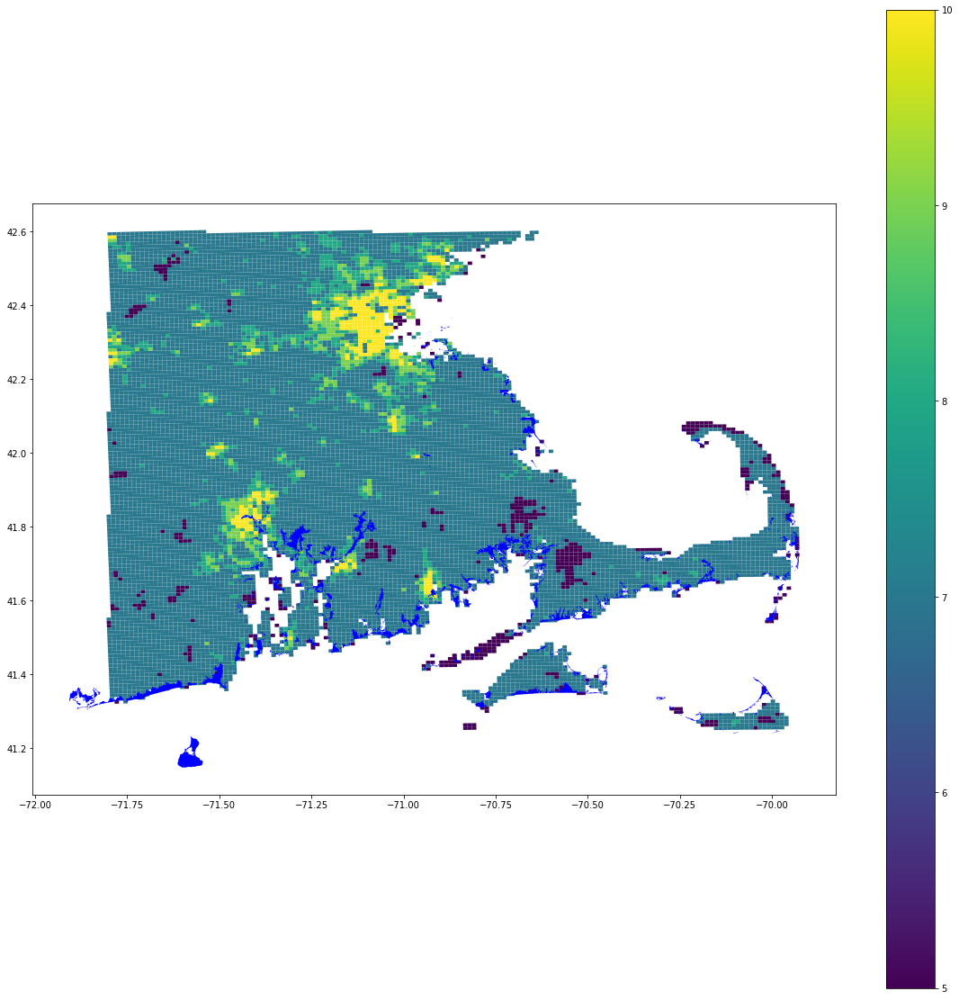

In [28]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)

In [0]:
#flood_pop=gpd.sjoin(flooding, game_grid)
#flood_pop

#All Facilities

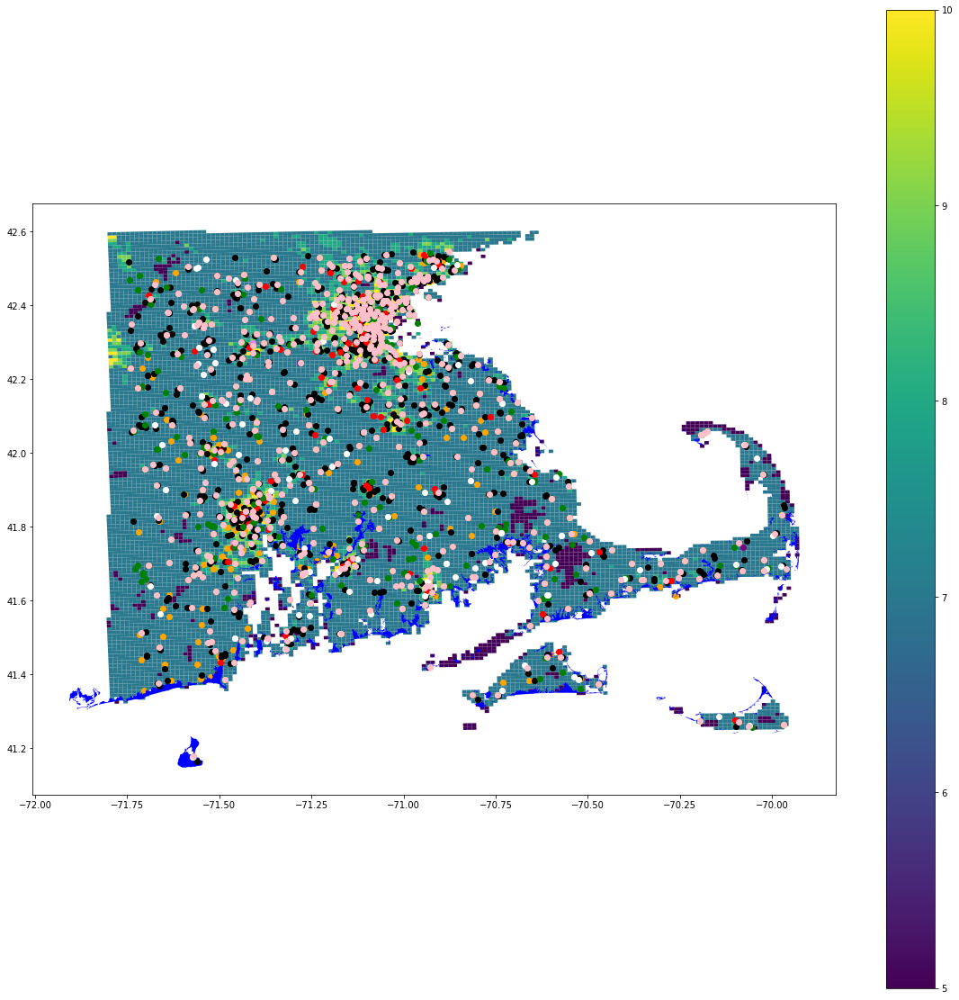

In [30]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)
plants.to_crs(game_grid.crs).plot(color='green', ax=ax, zorder=15)
towers.to_crs(game_grid.crs).plot(color='white', ax=ax, zorder=15)
stations.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5)
local_eo.to_crs(game_grid.crs).plot(color='purple', ax=ax, zorder=5)
state_eo.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)
EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)

All Working Facilities 

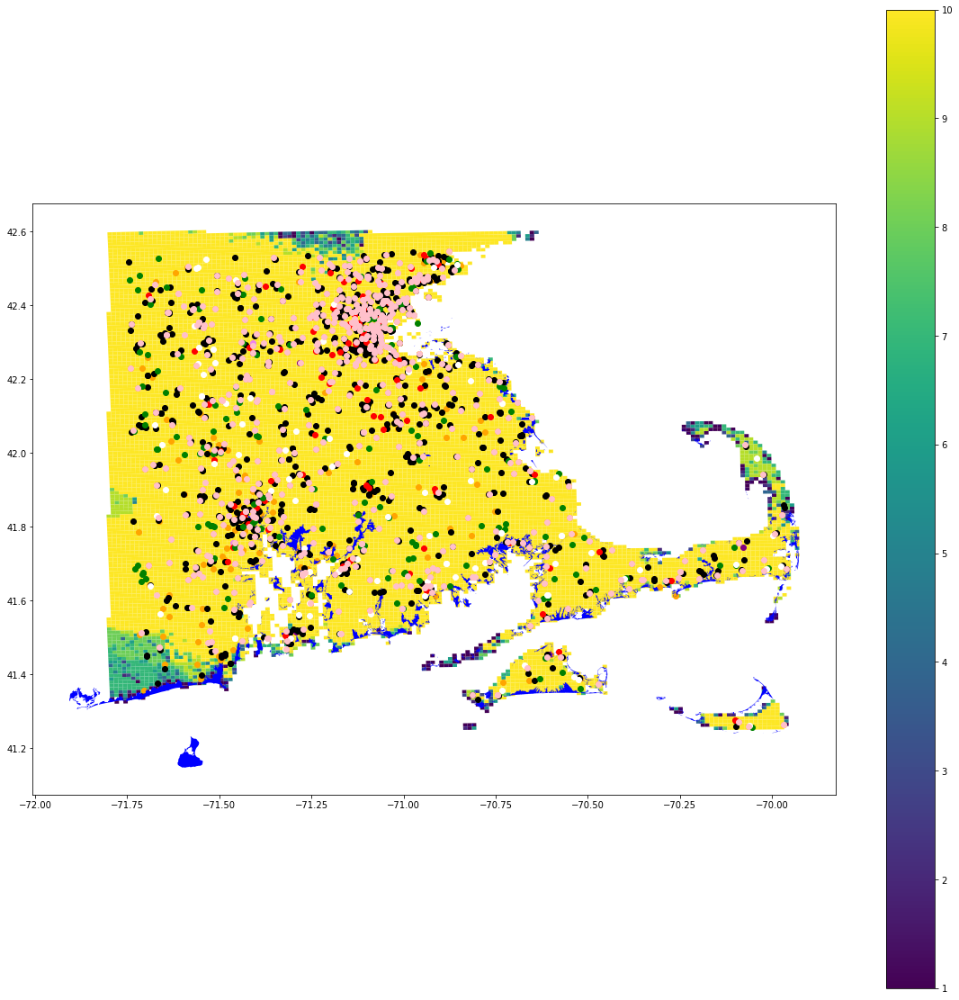

In [129]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
eff_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
eff_small_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
eff_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)
eff_plants.to_crs(game_grid.crs).plot(color='green', ax=ax, zorder=15)
eff_towers.to_crs(game_grid.crs).plot(color='white', ax=ax, zorder=15)
eff_stations.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5)
eff_lcl_eo.to_crs(game_grid.crs).plot(color='purple', ax=ax, zorder=5)
eff_stt_eo.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)
eff_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)
eff_big_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)
plt.savefig('hospitalround3.png')

All Non-Working Facilities

/usr/local/lib/python3.6/dist-packages/geopandas/plotting.py:418: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  "empty. Nothing has been displayed.", UserWarning)


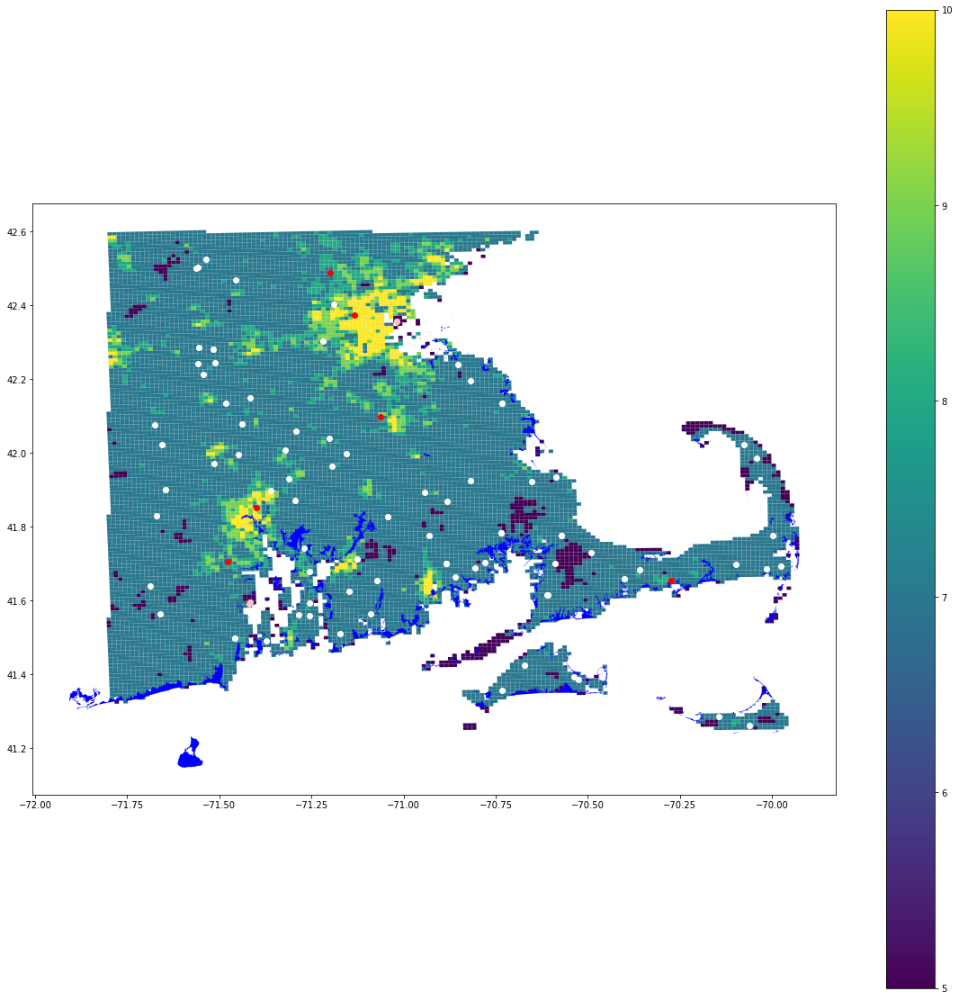

In [32]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
dead_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
dead_small_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
dead_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)
dead_plants.to_crs(game_grid.crs).plot(color='green', ax=ax, zorder=15)
dead_towers.to_crs(game_grid.crs).plot(color='white', ax=ax, zorder=15)
dead_stations.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5)
dead_lcl_eo.to_crs(game_grid.crs).plot(color='purple', ax=ax, zorder=5)
dead_stt_eo.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)
dead_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)
dead_big_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)

All Supplied Facilities

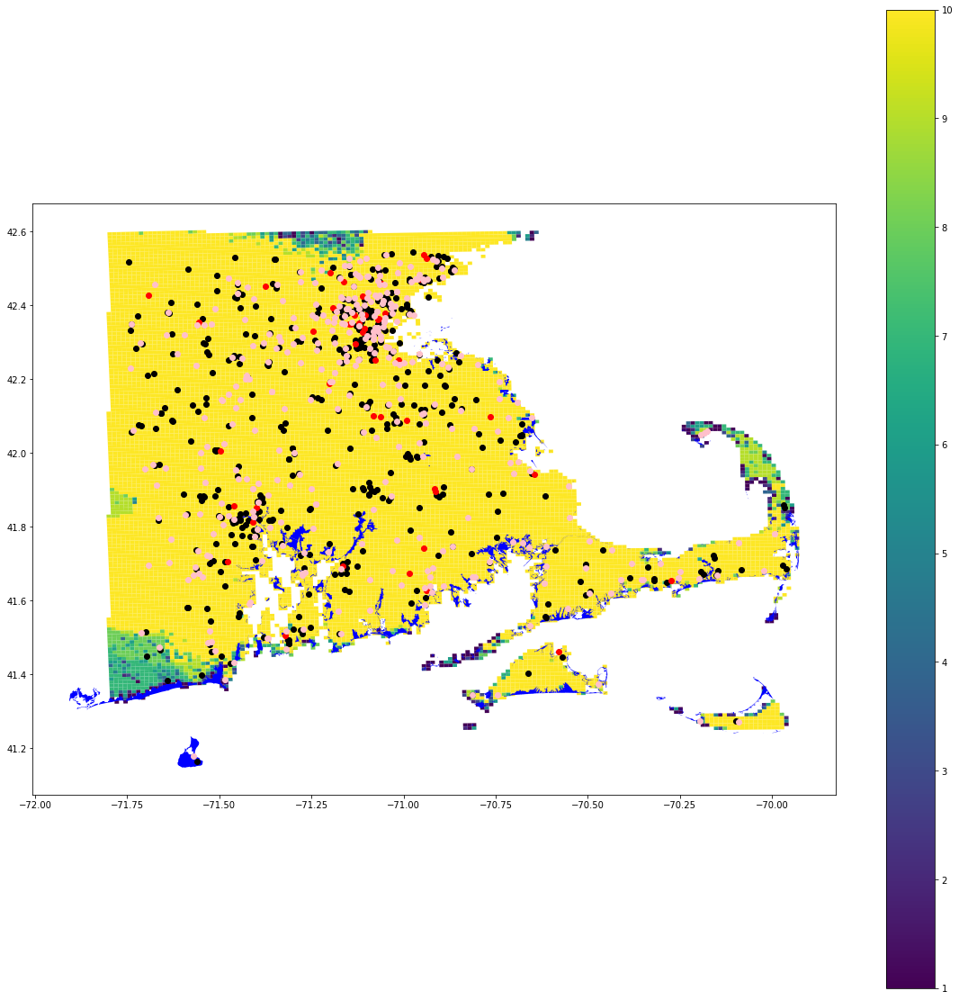

In [130]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
ws_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
ws_small_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
ws_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)
ws_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)
ws_big_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)

All Non-Supplied Facilities

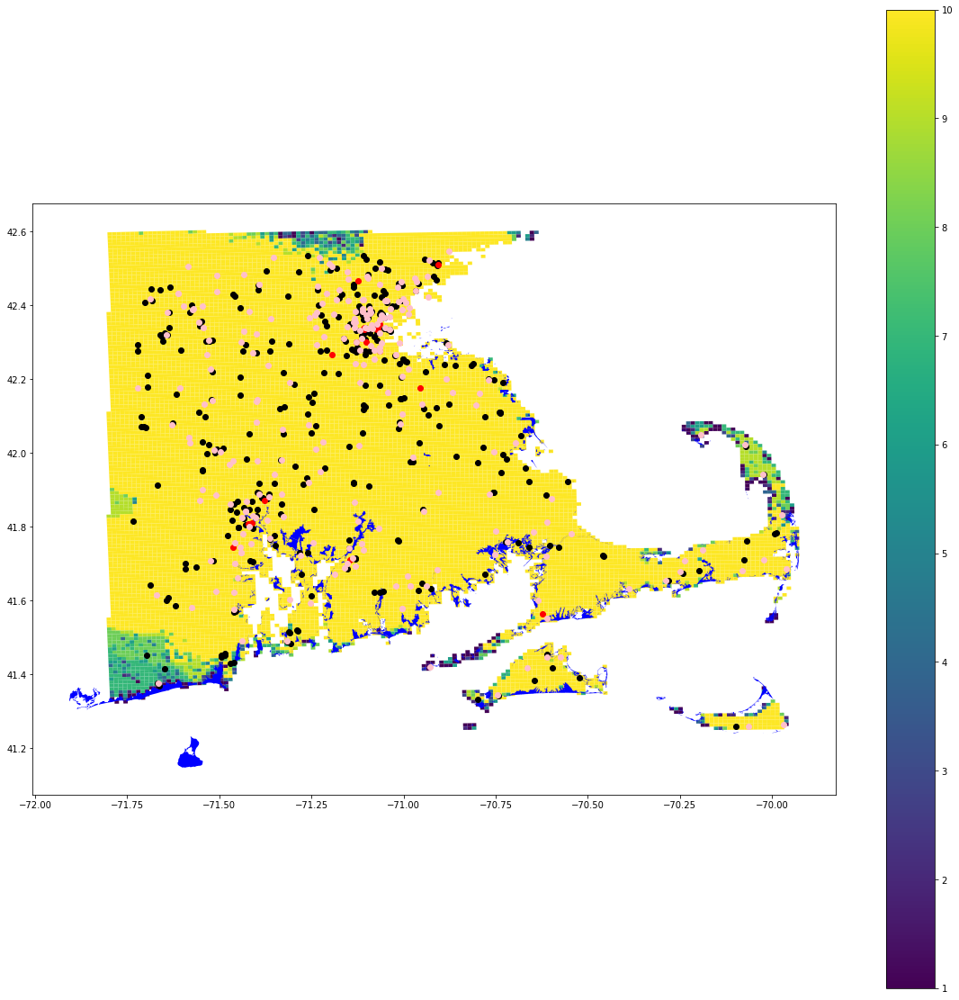

In [131]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
oos_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
oos_small_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
oos_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)
oos_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)
oos_big_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=15)

#All Hospitals and EMS

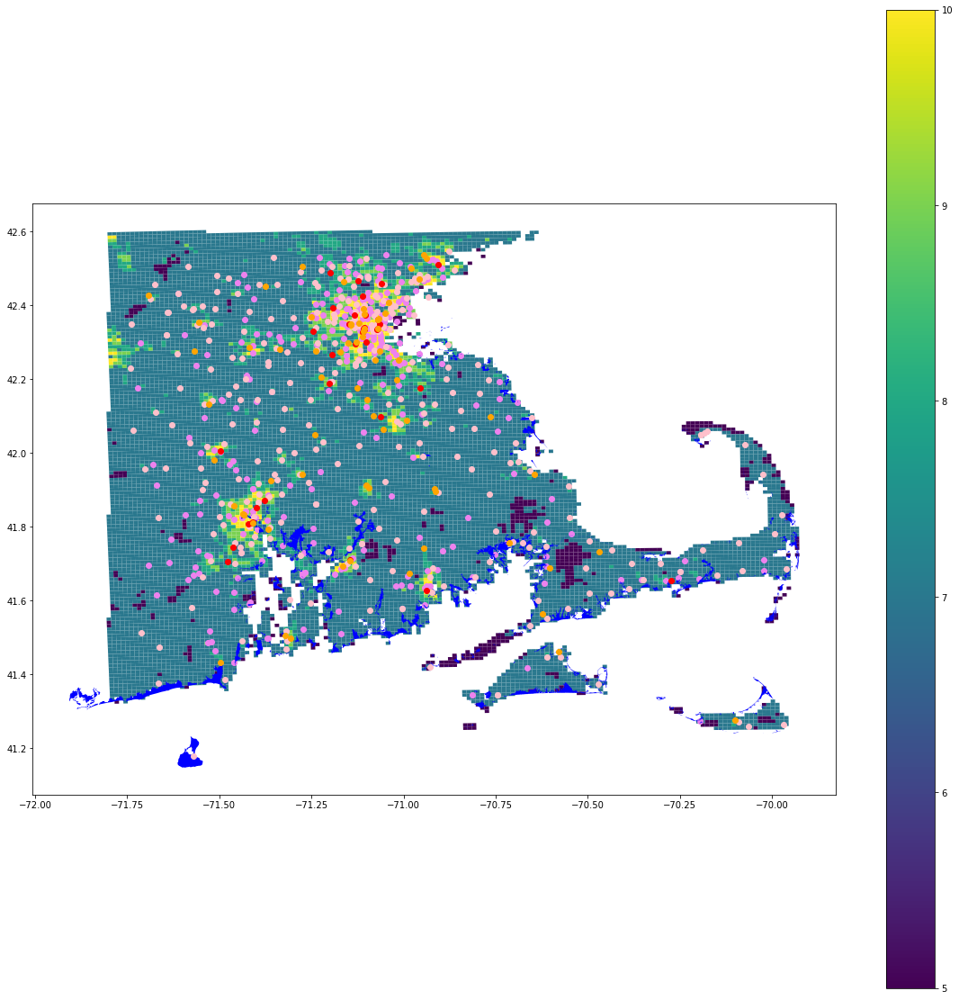

In [33]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
small_hospitals.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10)
big_EMS.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

All Working Hospitals and EMS

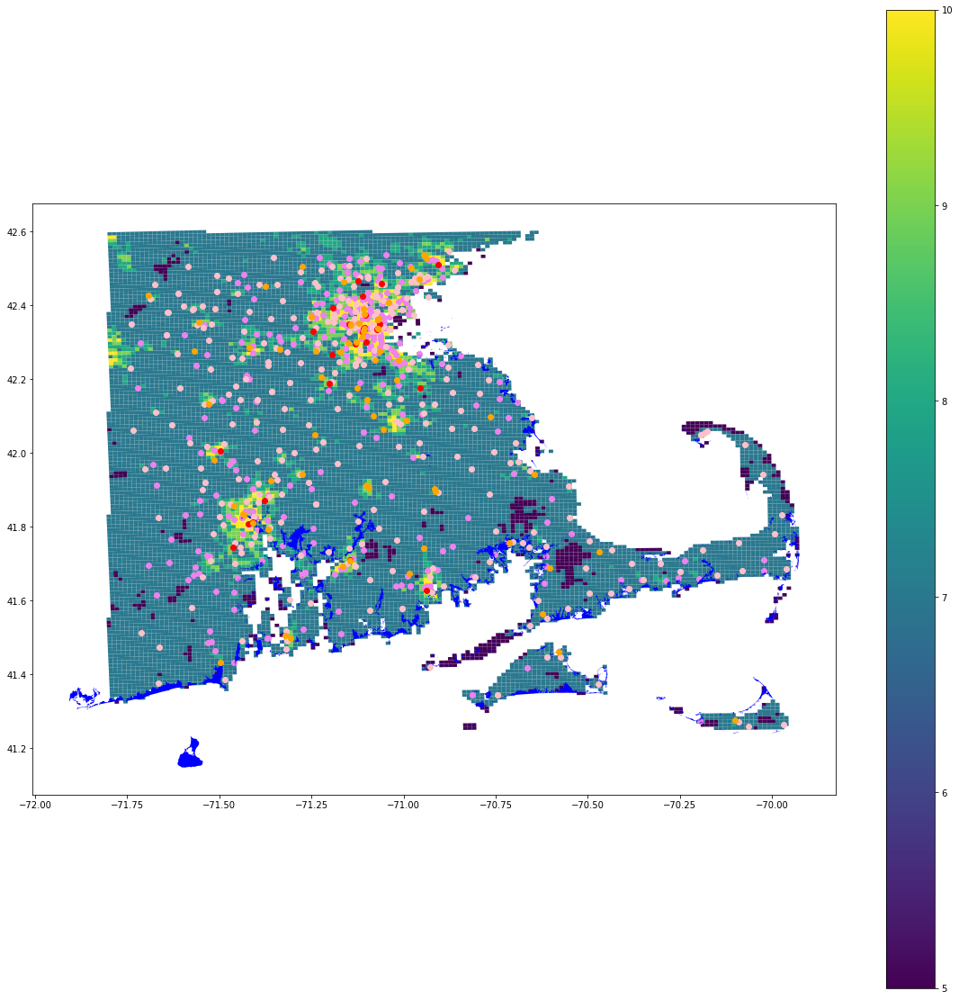

In [34]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
eff_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
eff_small_hospitals.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
eff_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10)
eff_big_EMS.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

All Non-Working Hospitals and EMS

/usr/local/lib/python3.6/dist-packages/geopandas/plotting.py:418: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  "empty. Nothing has been displayed.", UserWarning)


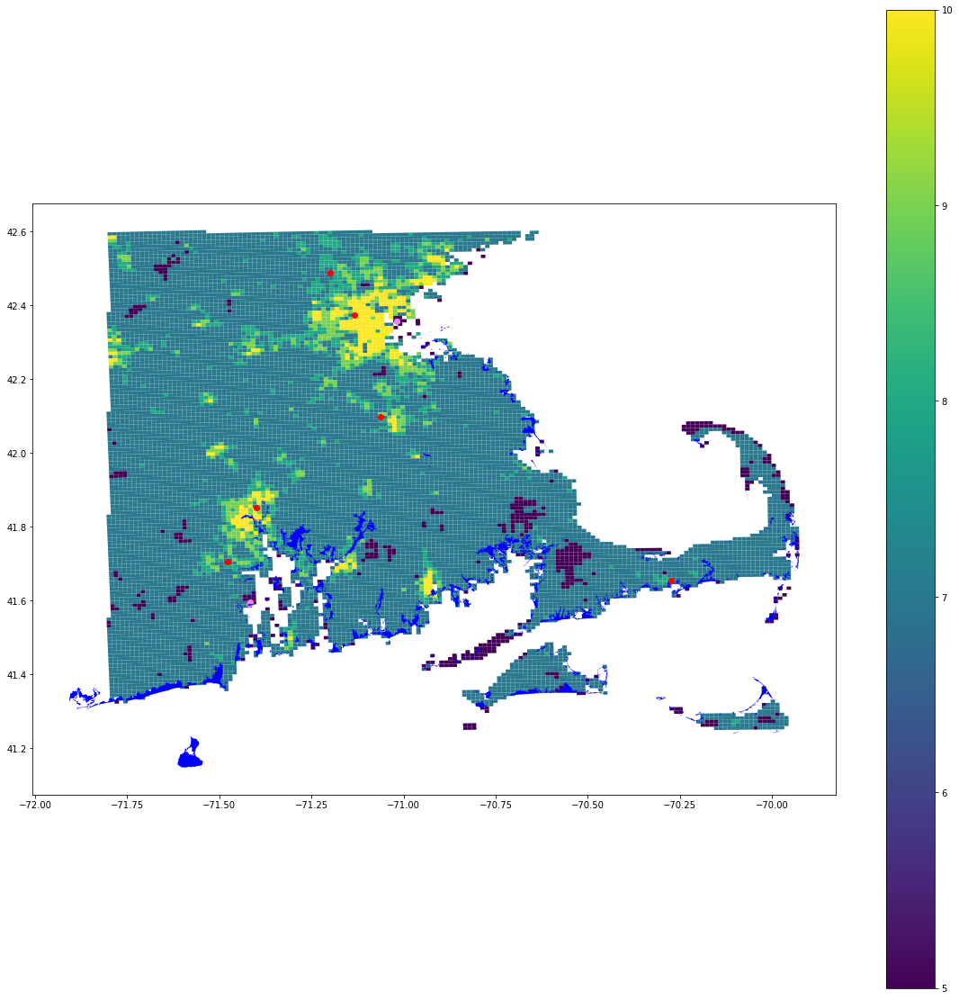

In [35]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
dead_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
dead_small_hospitals.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
dead_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10)
dead_big_EMS.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

All Supplied Hospitals and EMS

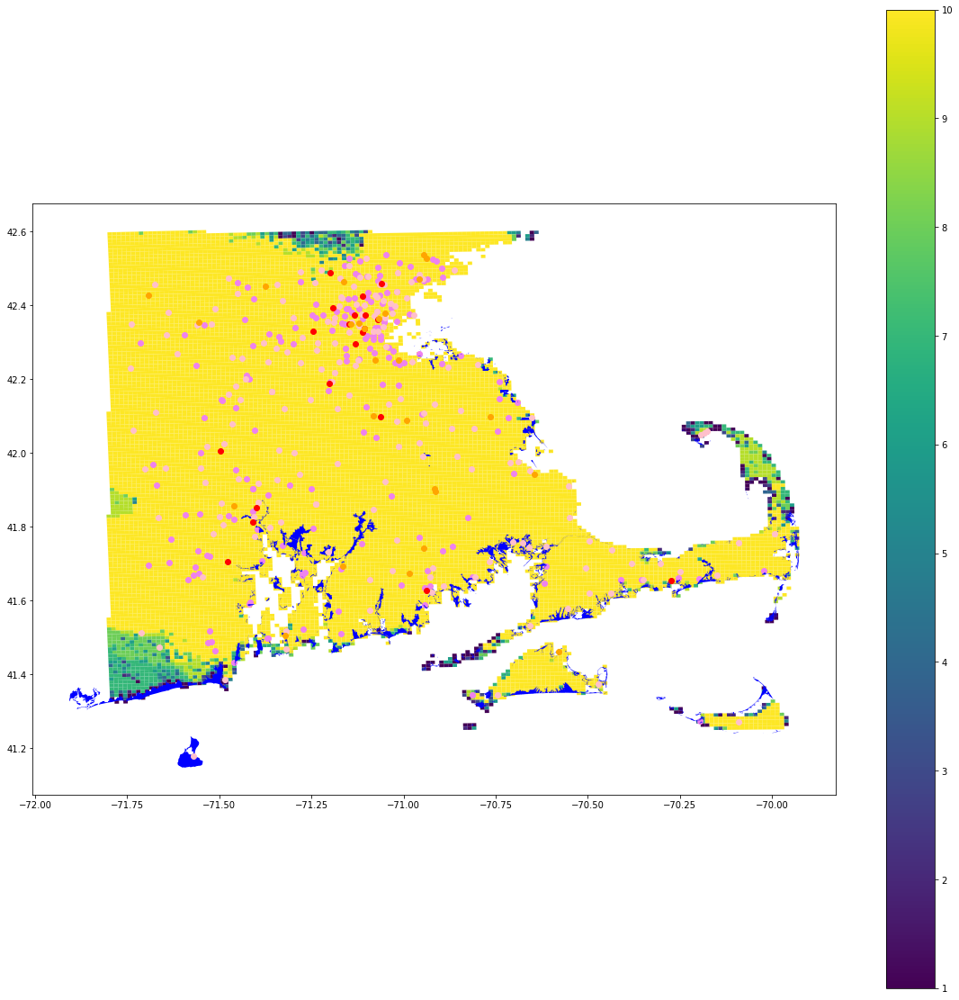

In [165]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
ws_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
ws_small_hospitals.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
ws_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10)
ws_big_EMS.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

Non-Supplied Hospitals and EMS

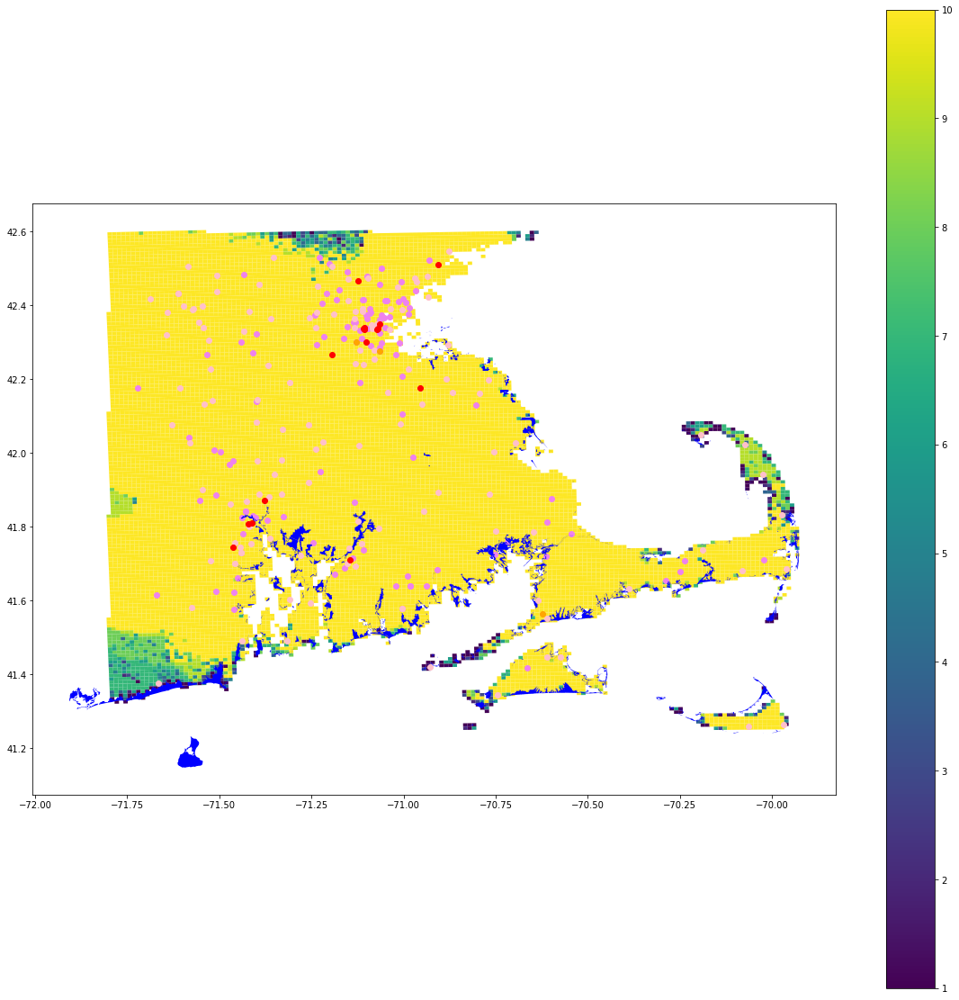

In [164]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
oos_big_hospitals.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)
oos_small_hospitals.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
oos_small_EMS.to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10)
oos_big_EMS.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

Hospital and EMS Coverage

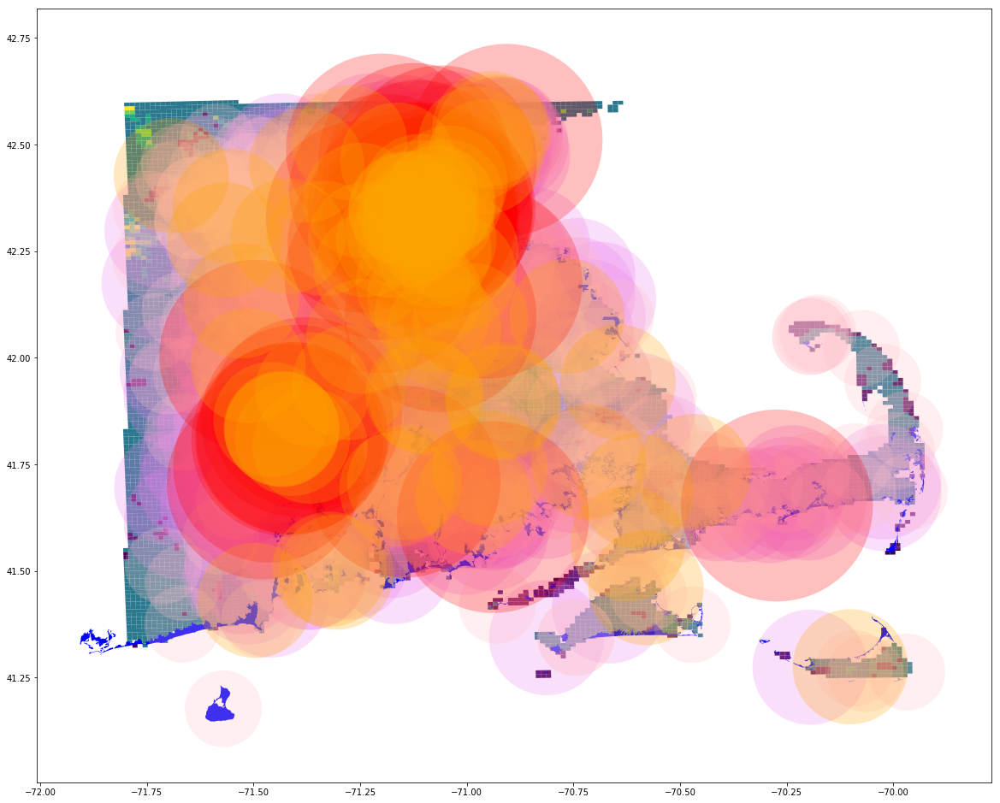

In [36]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
big_hospitals.buffer(0.22522522522).to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15, alpha=0.25)
small_hospitals.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15, alpha=0.25)
small_EMS.buffer(0.09009009009).to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10, alpha=0.25)
big_EMS.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5, alpha=0.25)

Working Hospital and EMS Coverage

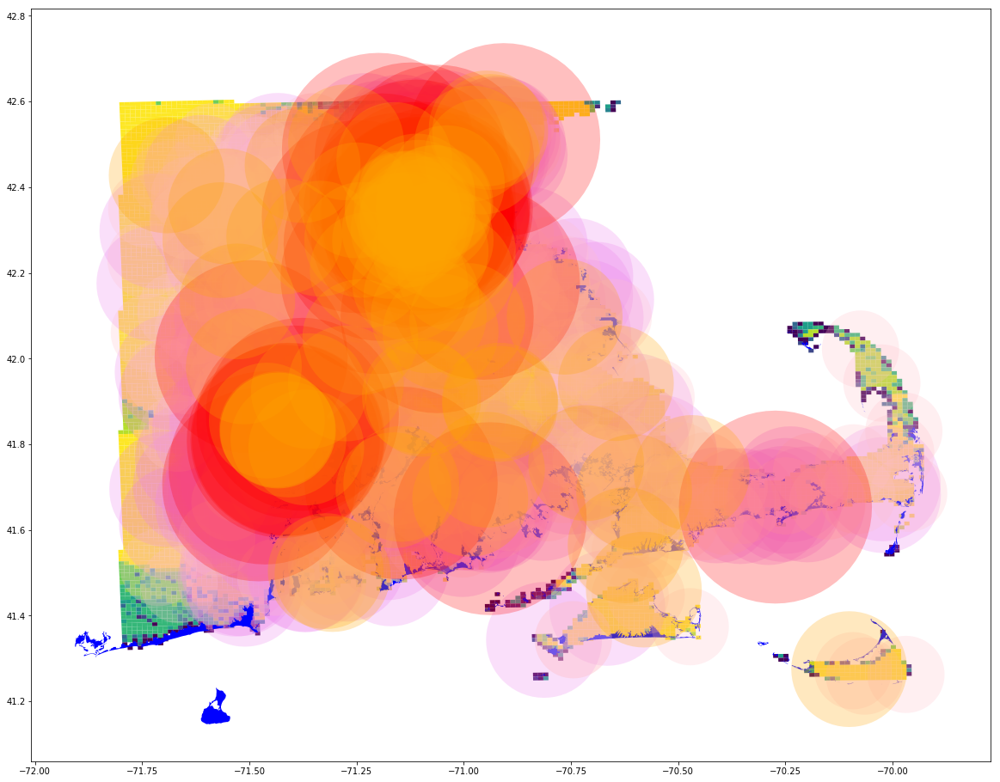

In [166]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
eff_big_hospitals.buffer(0.22522522522).to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15, alpha=0.25)
eff_small_hospitals.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15, alpha=0.25)
eff_small_EMS.buffer(0.09009009009).to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10, alpha=0.25)
eff_big_EMS.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5, alpha=0.25)

Supplied Hospital and EMS Coverage

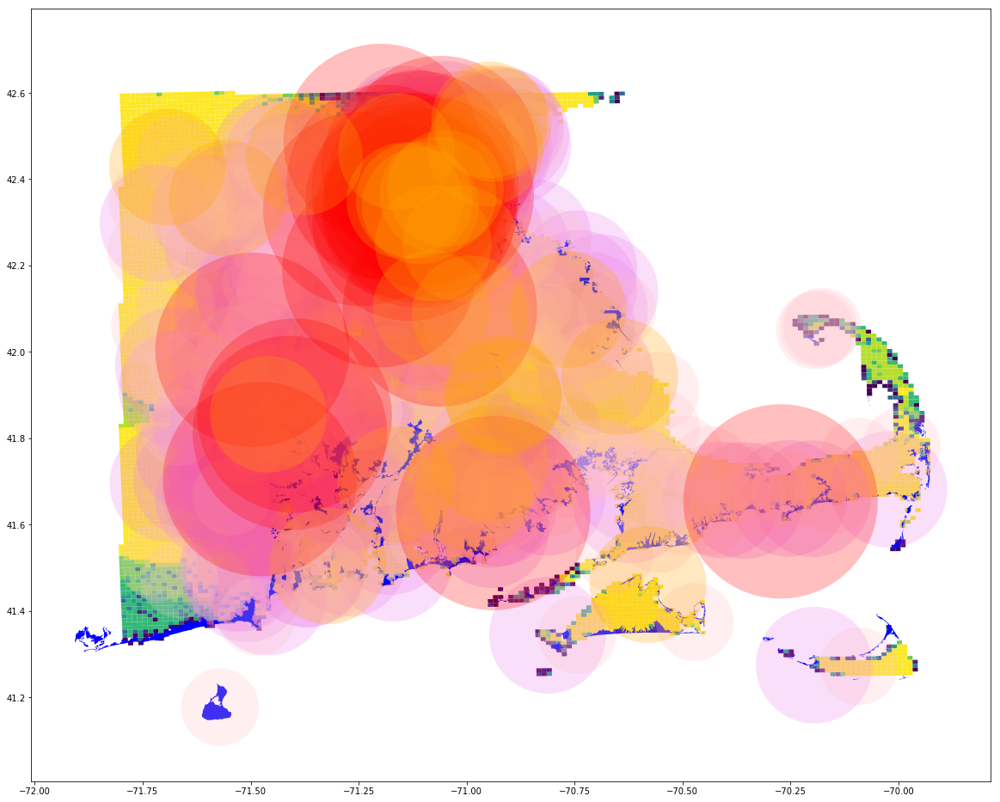

In [167]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
ws_big_hospitals.buffer(0.22522522522).to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15, alpha=0.25)
ws_small_hospitals.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=15, alpha=0.25)
ws_small_EMS.buffer(0.09009009009).to_crs(game_grid.crs).plot(color='pink', ax=ax, zorder=10, alpha=0.25)
ws_big_EMS.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5, alpha=0.25)

#Shelters

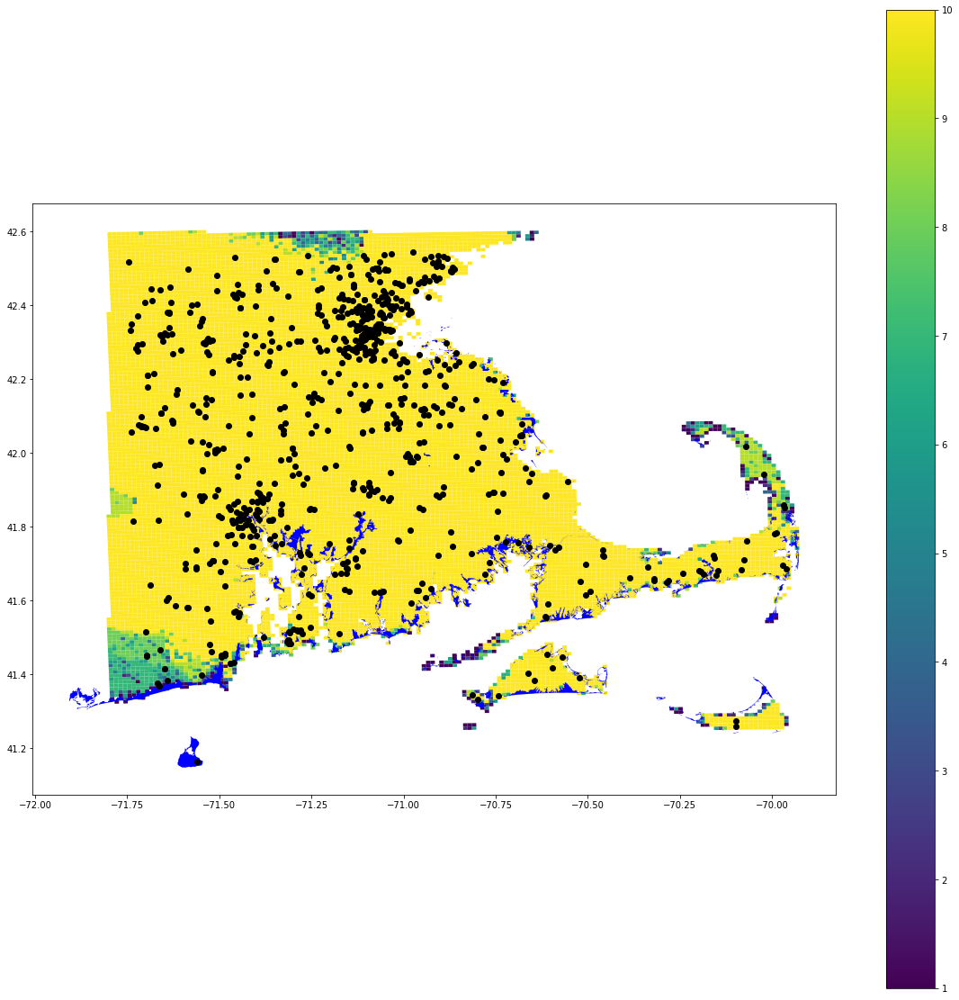

In [144]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)

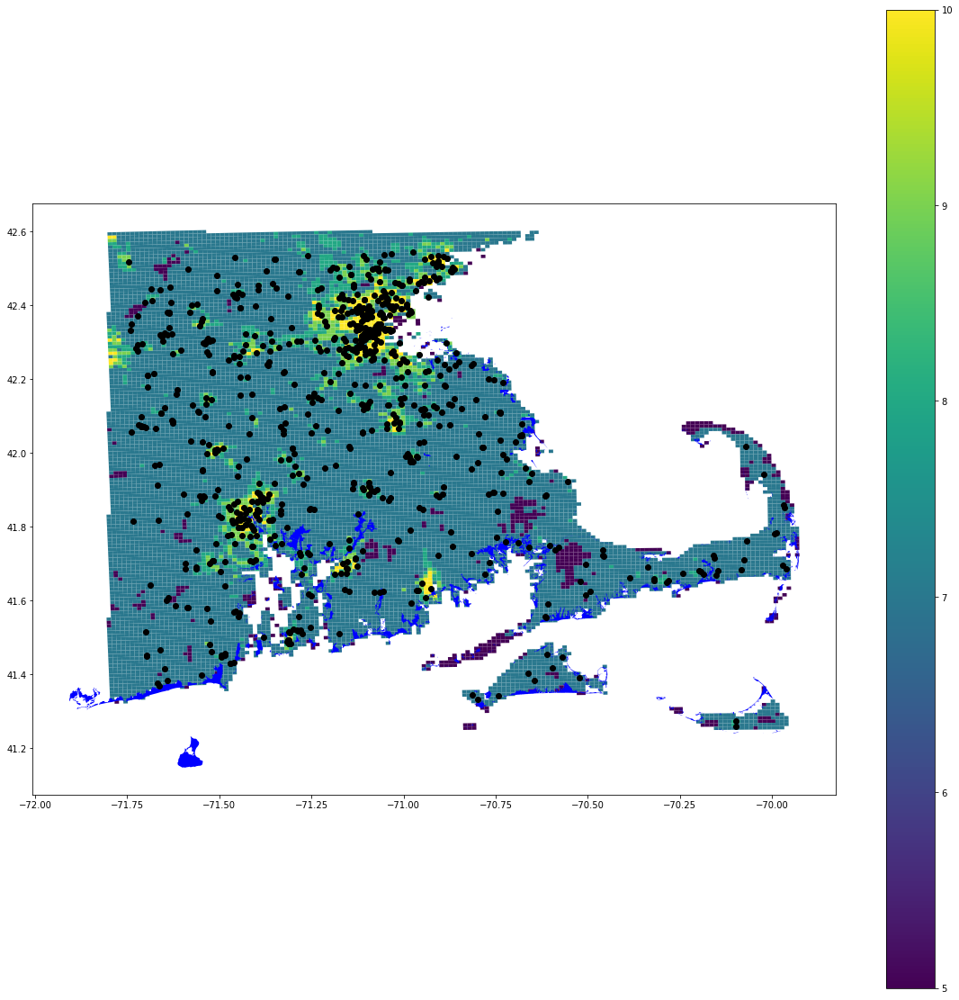

In [39]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
eff_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)

/usr/local/lib/python3.6/dist-packages/geopandas/plotting.py:418: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  "empty. Nothing has been displayed.", UserWarning)


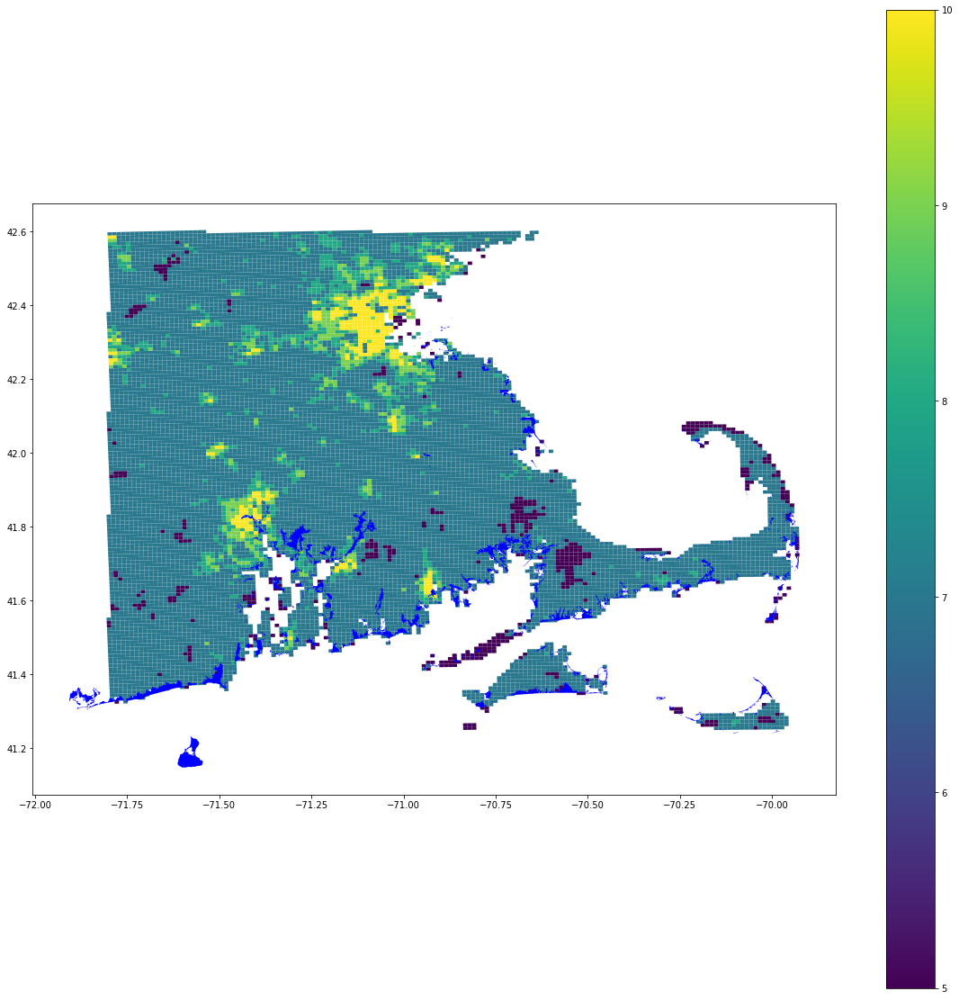

In [40]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
dead_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)

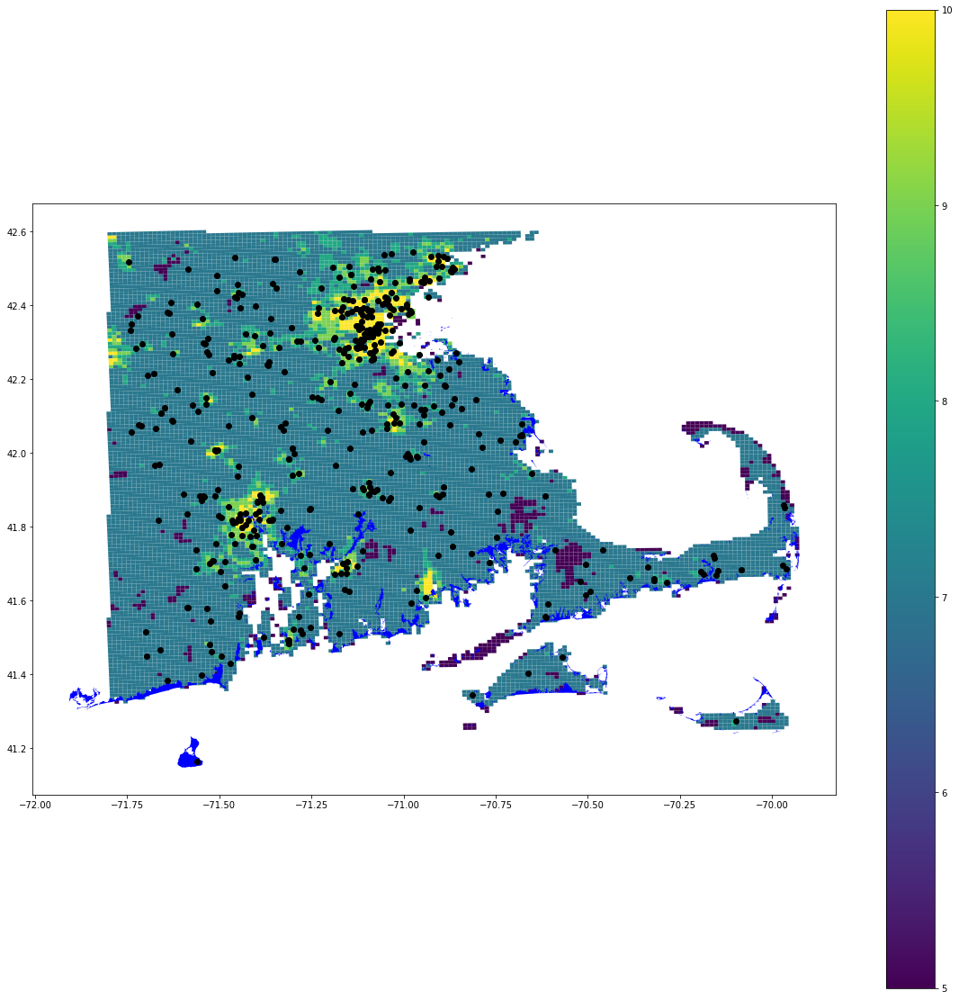

In [116]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
ws_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)

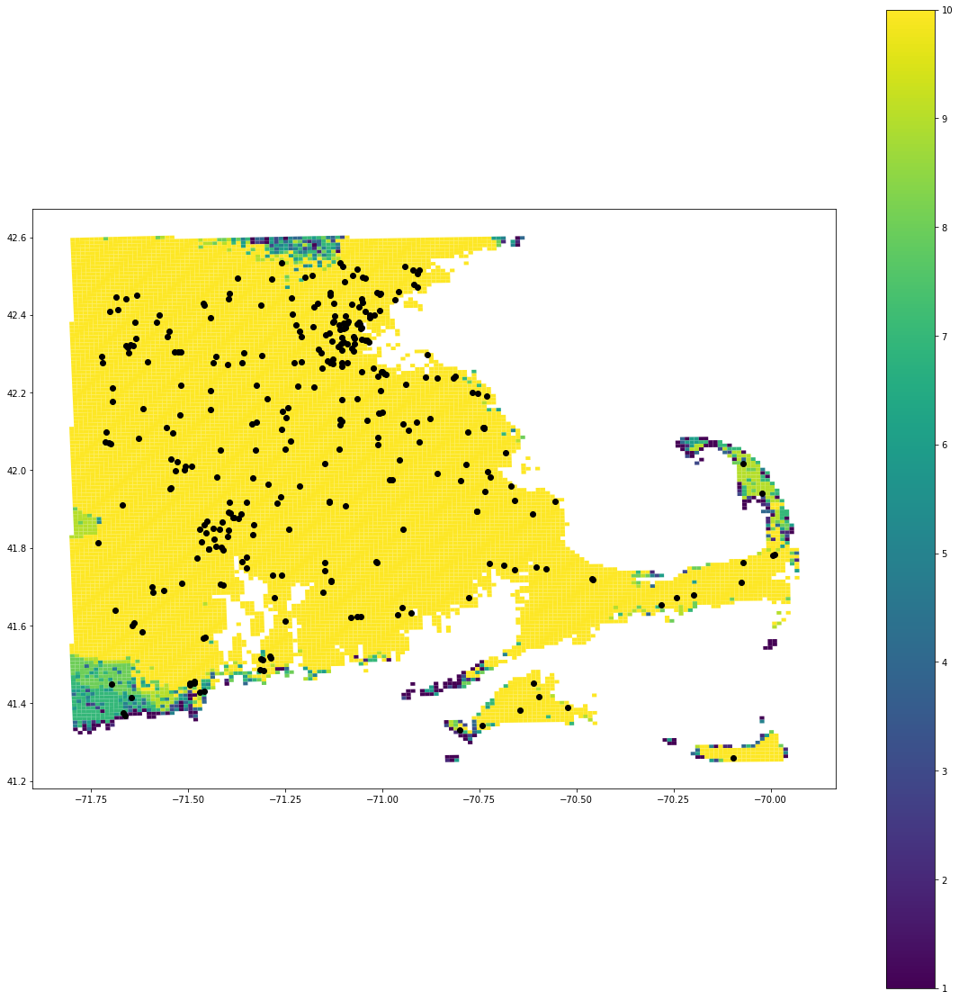

In [159]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
oos_shelters.to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10)

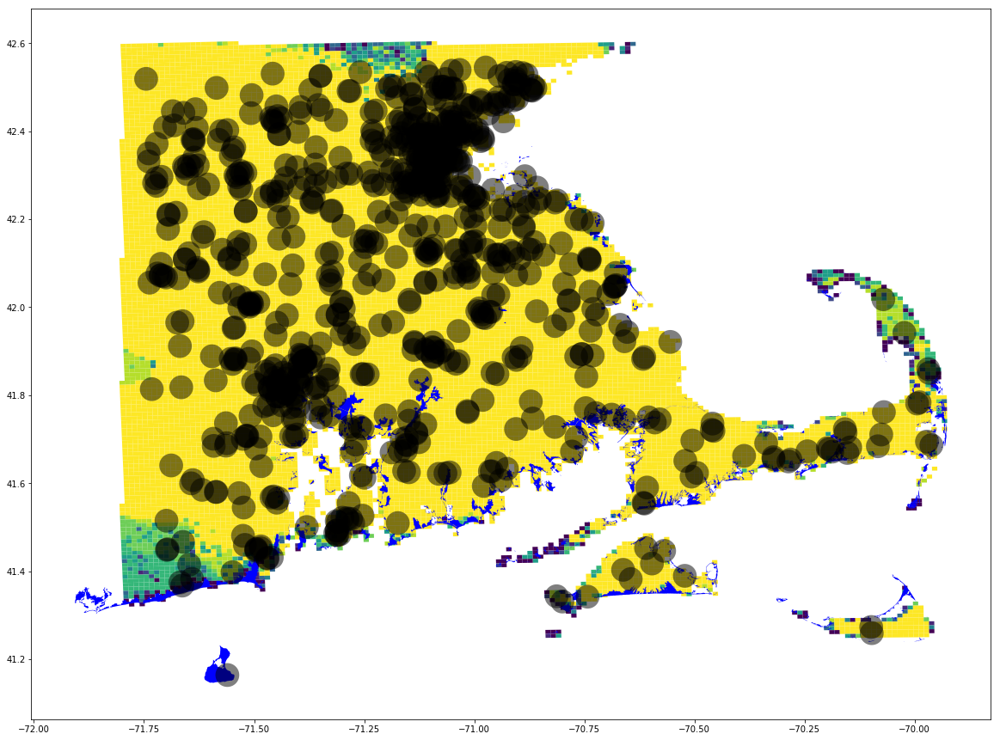

In [146]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
shelters.buffer(0.02702702702).to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10, alpha=.5)

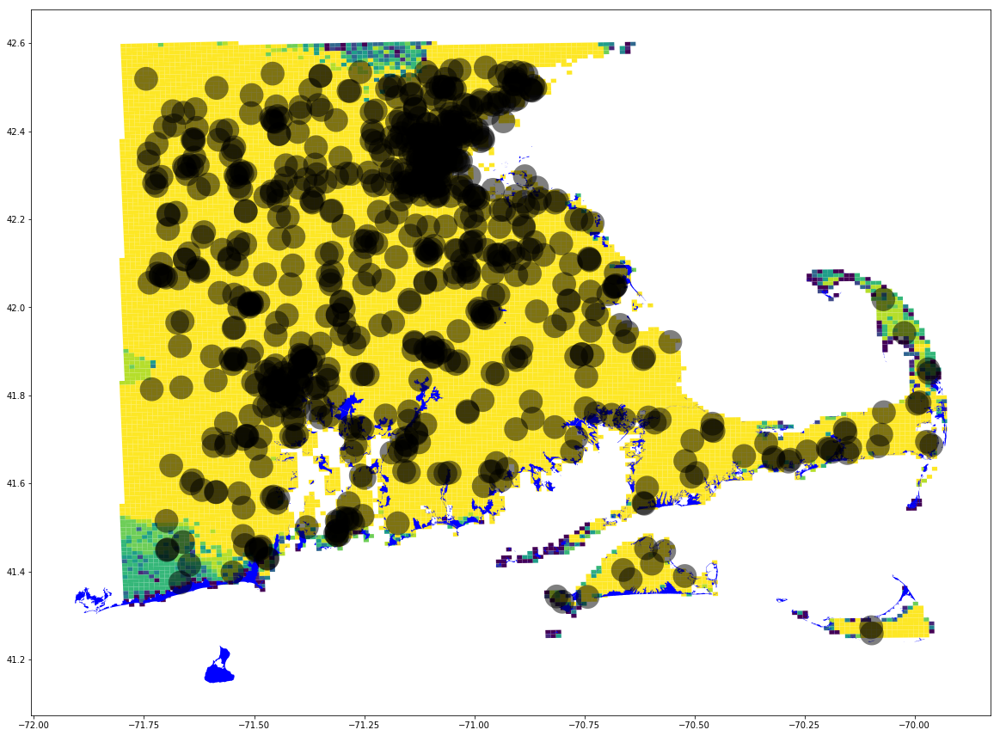

In [147]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
eff_shelters.buffer(0.02702702702).to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10, alpha=.5)

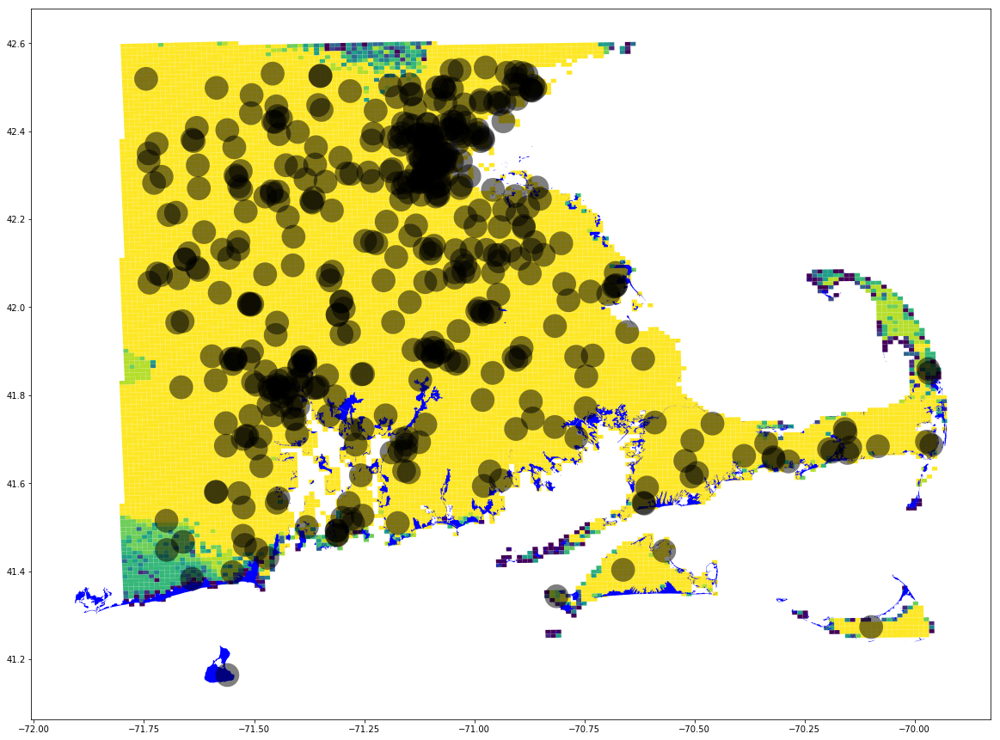

In [148]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
ws_shelters.buffer(0.02702702702).to_crs(game_grid.crs).plot(color='black', ax=ax, zorder=10, alpha=.5)

#Power Plants and Cell Towers

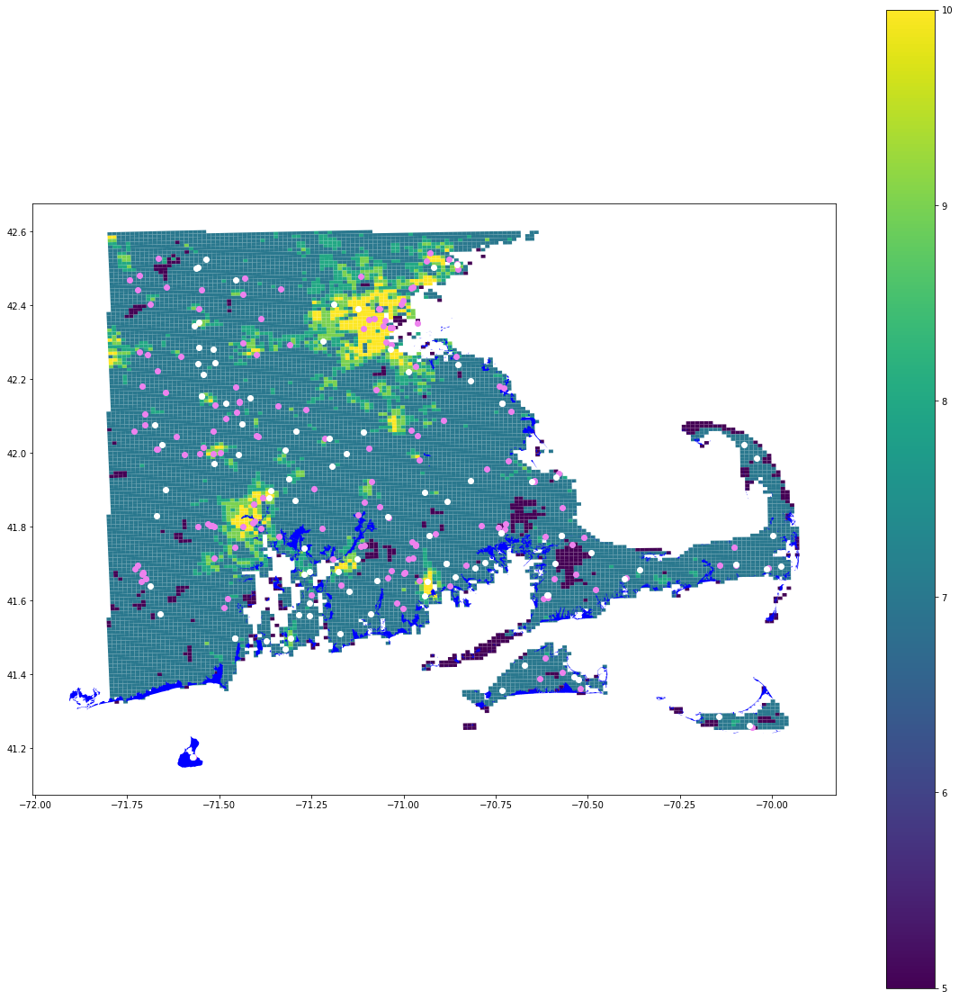

In [43]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
plants.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=15)
towers.to_crs(game_grid.crs).plot(color='white', ax=ax, zorder=15)

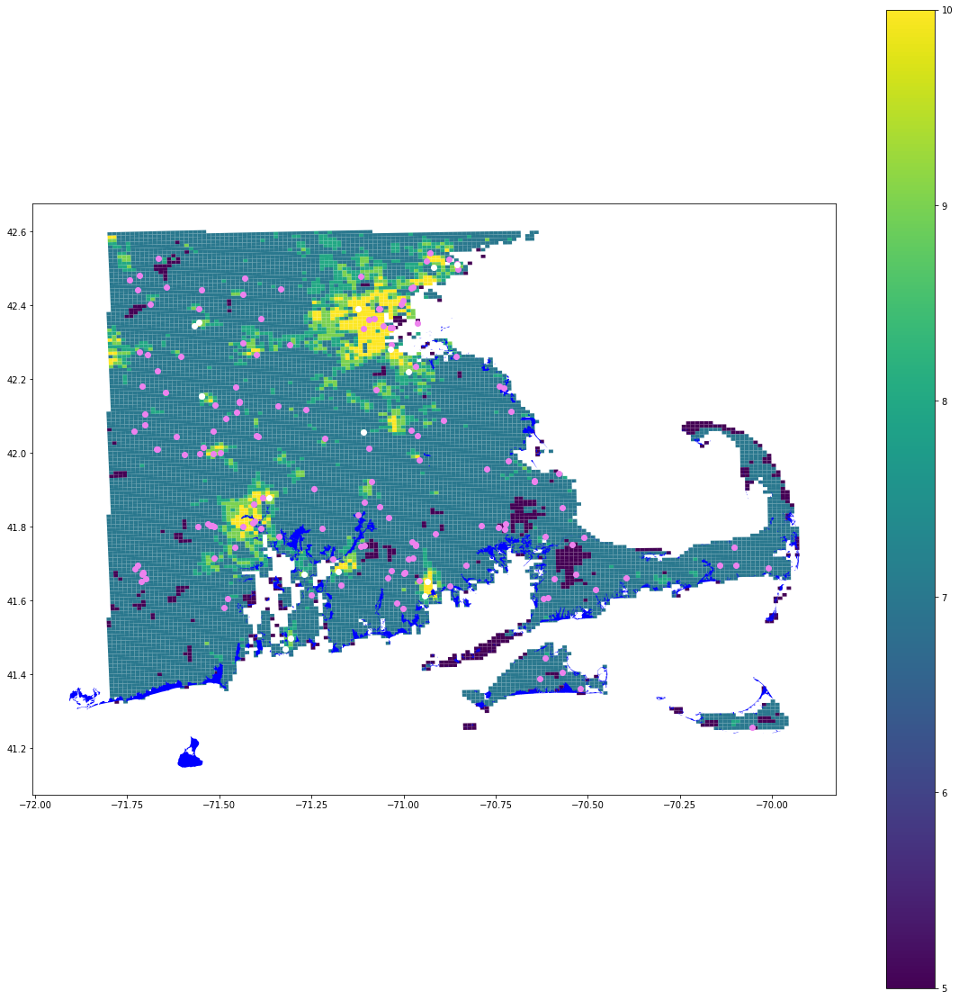

In [44]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
eff_plants.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=15)
eff_towers.to_crs(game_grid.crs).plot(color='white', ax=ax, zorder=15)

/usr/local/lib/python3.6/dist-packages/geopandas/plotting.py:418: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  "empty. Nothing has been displayed.", UserWarning)


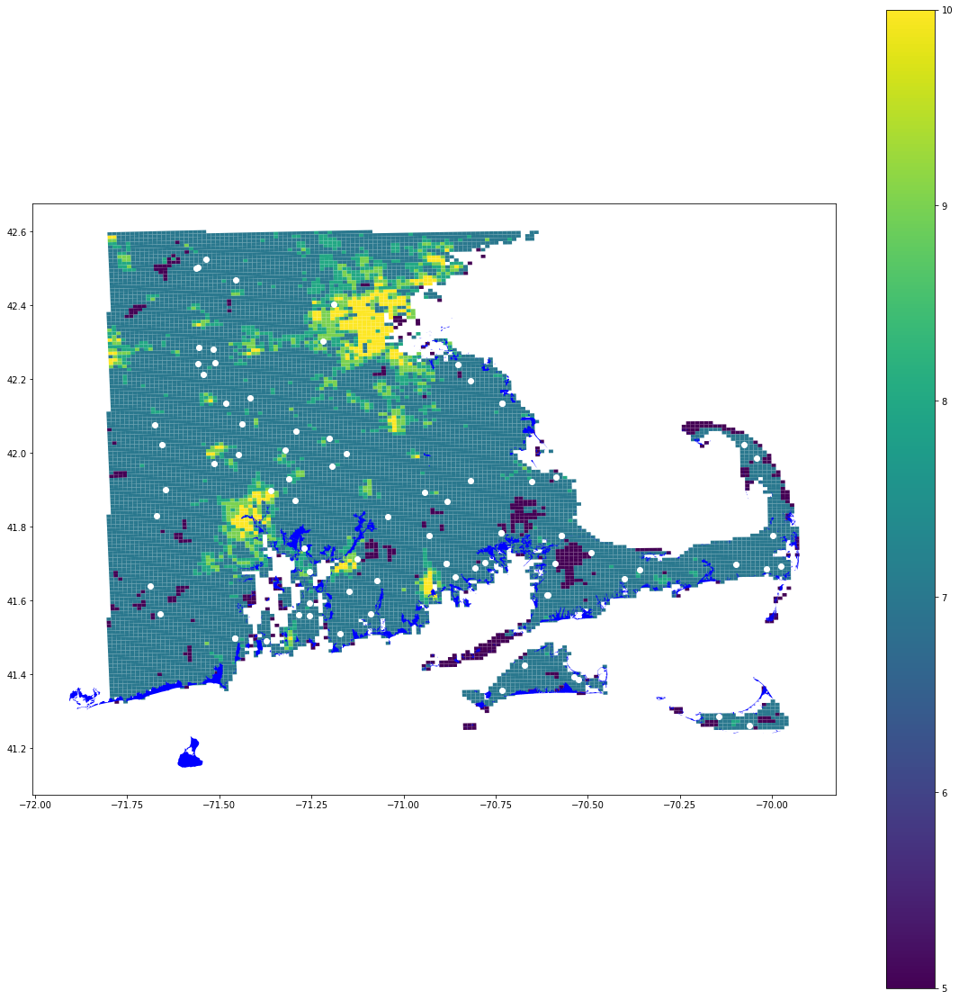

In [45]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
dead_plants.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=15)
dead_towers.to_crs(game_grid.crs).plot(color='white', ax=ax, zorder=15)

Power Plant Coverage

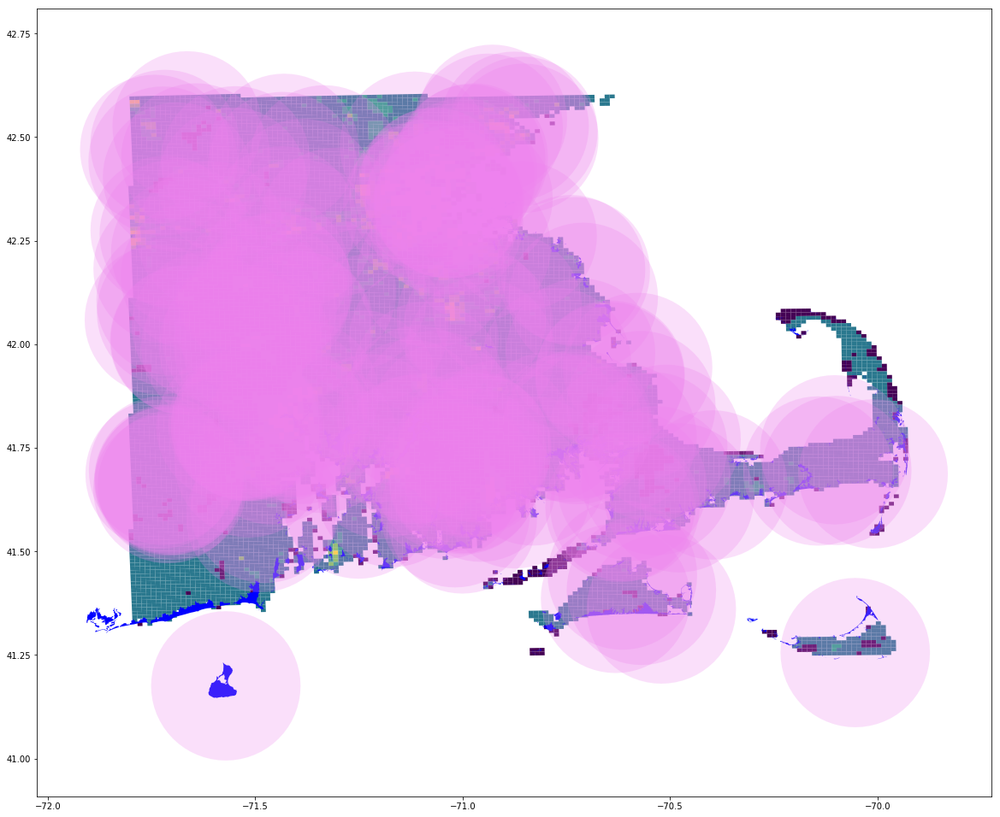

In [46]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
plants.buffer(0.18018018018).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=20, alpha=0.25)

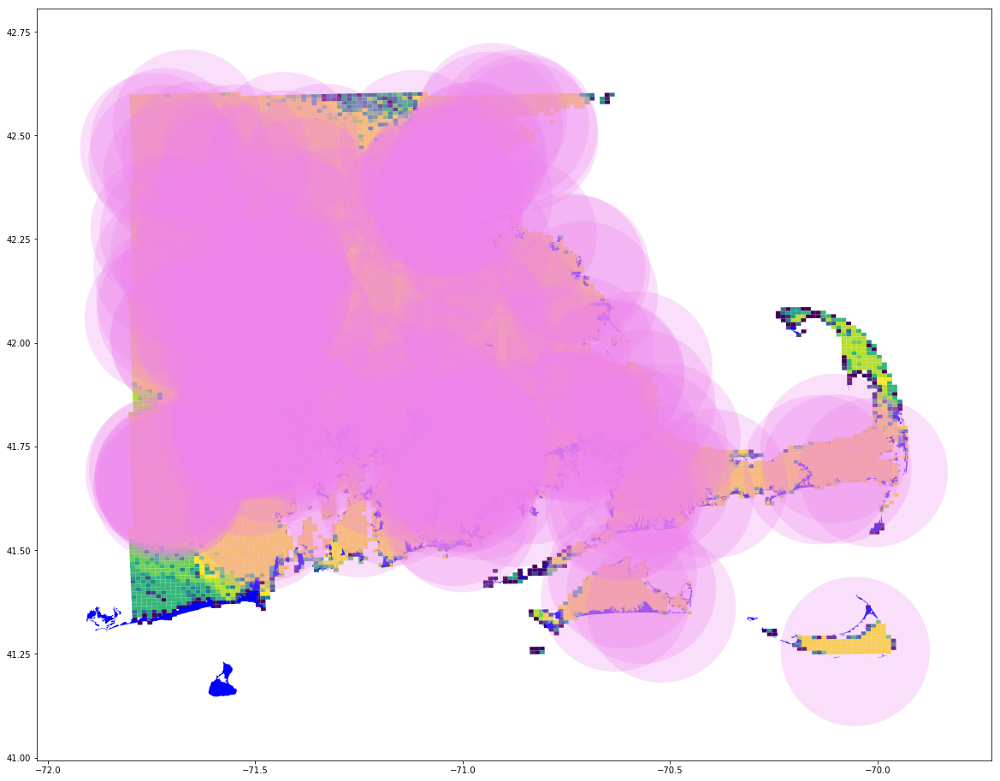

In [163]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
eff_plants.buffer(0.18018018018).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=20, alpha=0.25)

Cell Tower Coverage

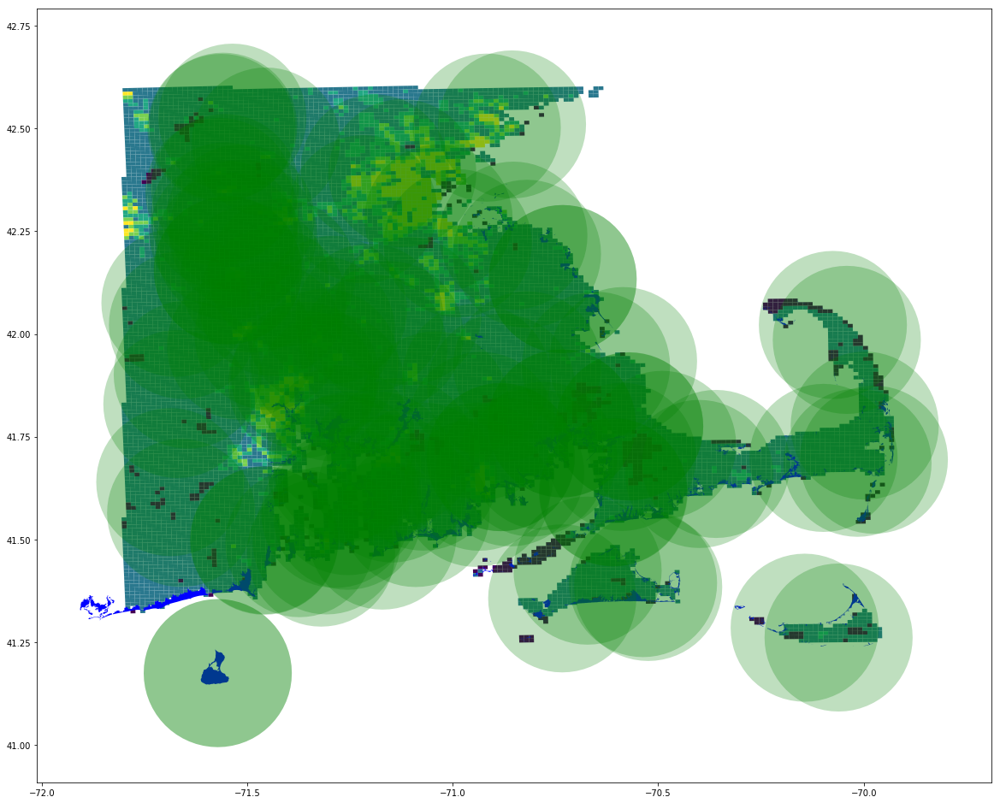

In [48]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
towers.buffer(0.18018018018).to_crs(game_grid.crs).plot(color='green', ax=ax, zorder=15, alpha=0.25)

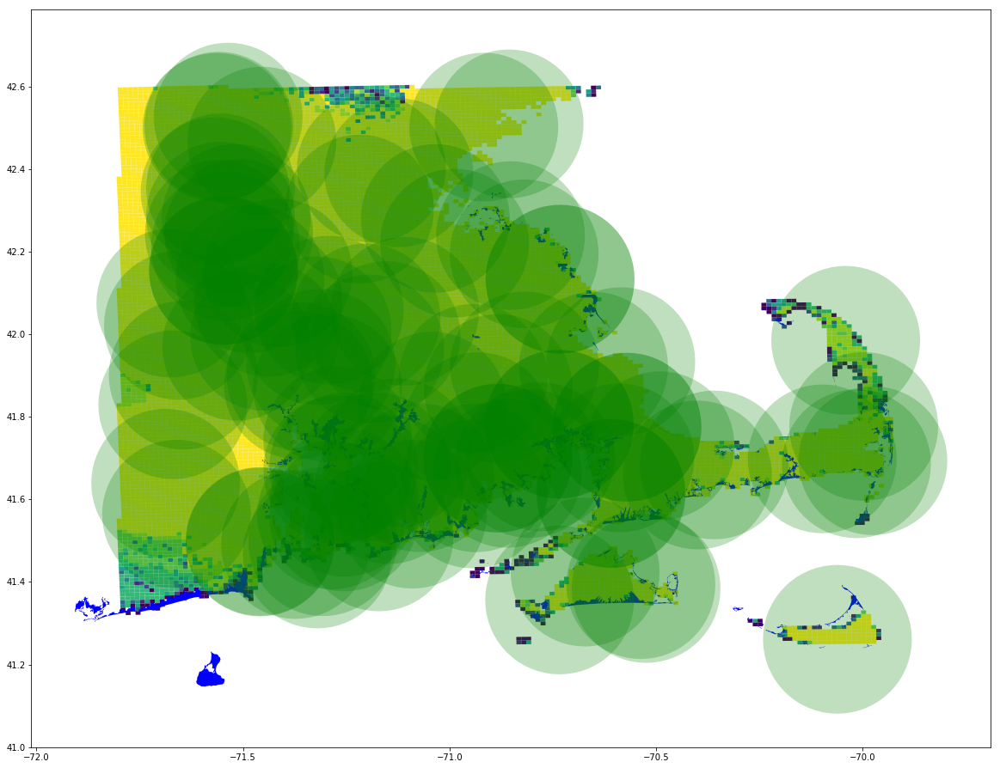

In [162]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
eff_towers.buffer(0.18018018018).to_crs(game_grid.crs).plot(color='green', ax=ax, zorder=15, alpha=0.25)

#Fire Stations

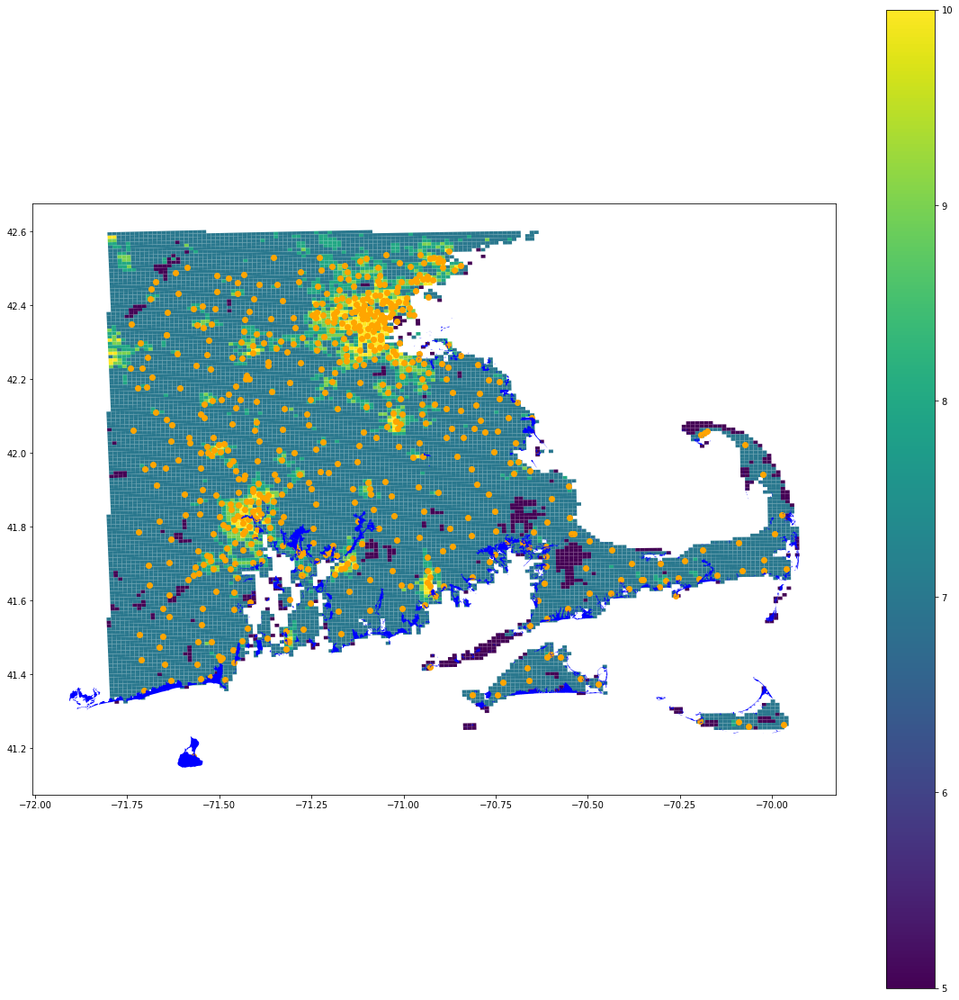

In [50]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
stations.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5)

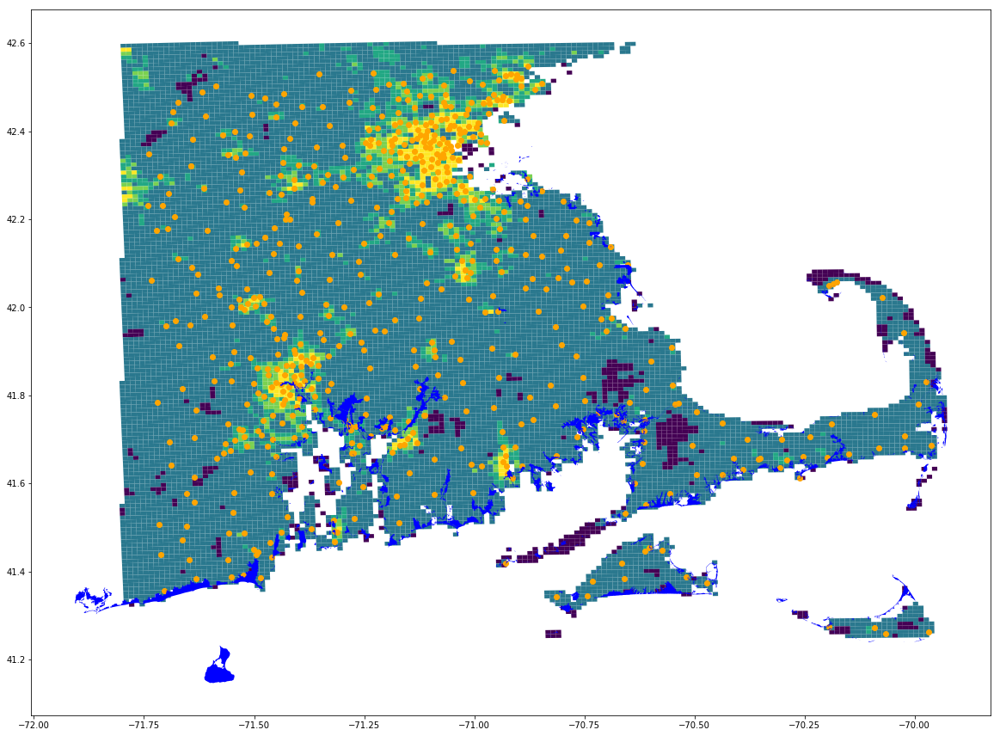

In [51]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
eff_stations.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5)

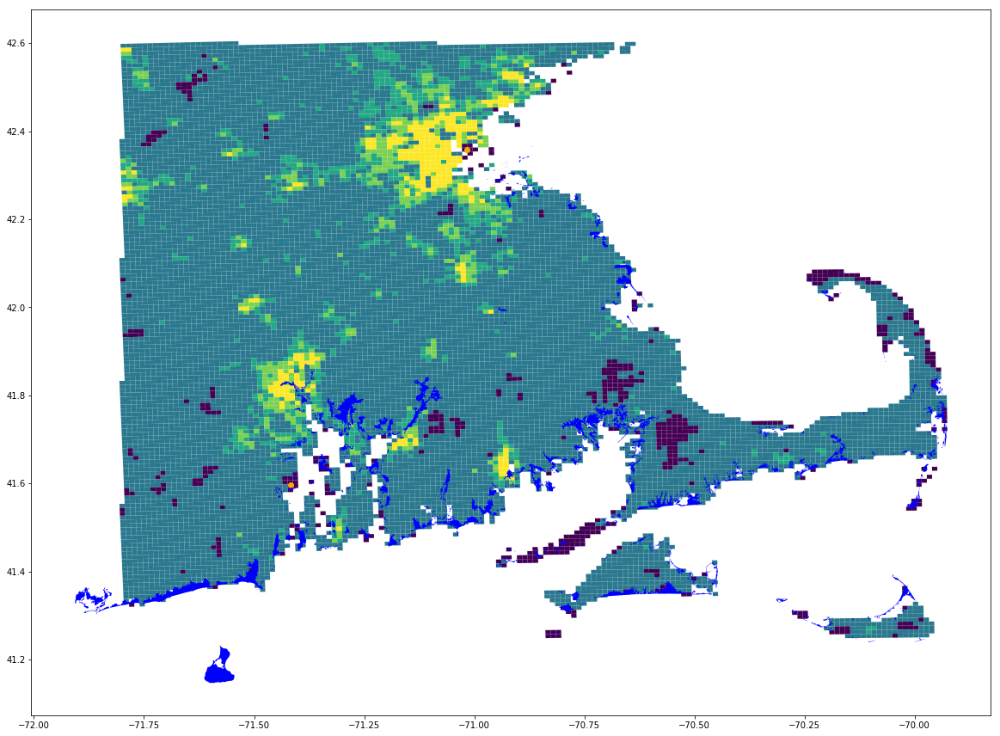

In [52]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
dead_stations.to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5)

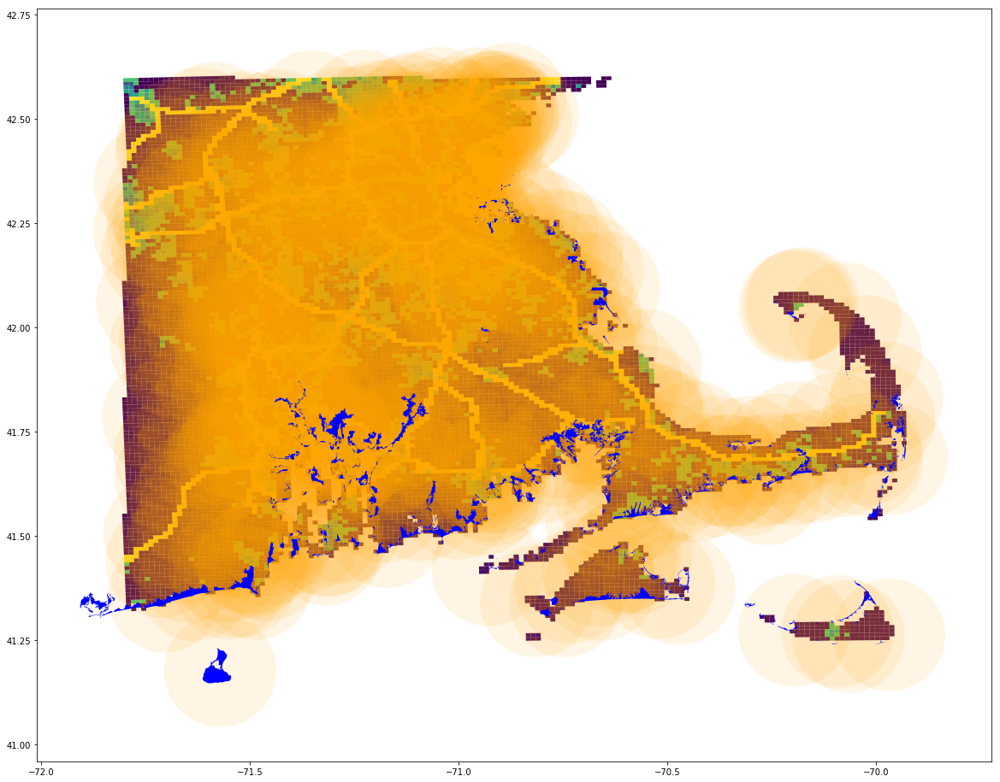

In [53]:
#transportation
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Transporta')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
stations.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5, alpha=0.1)

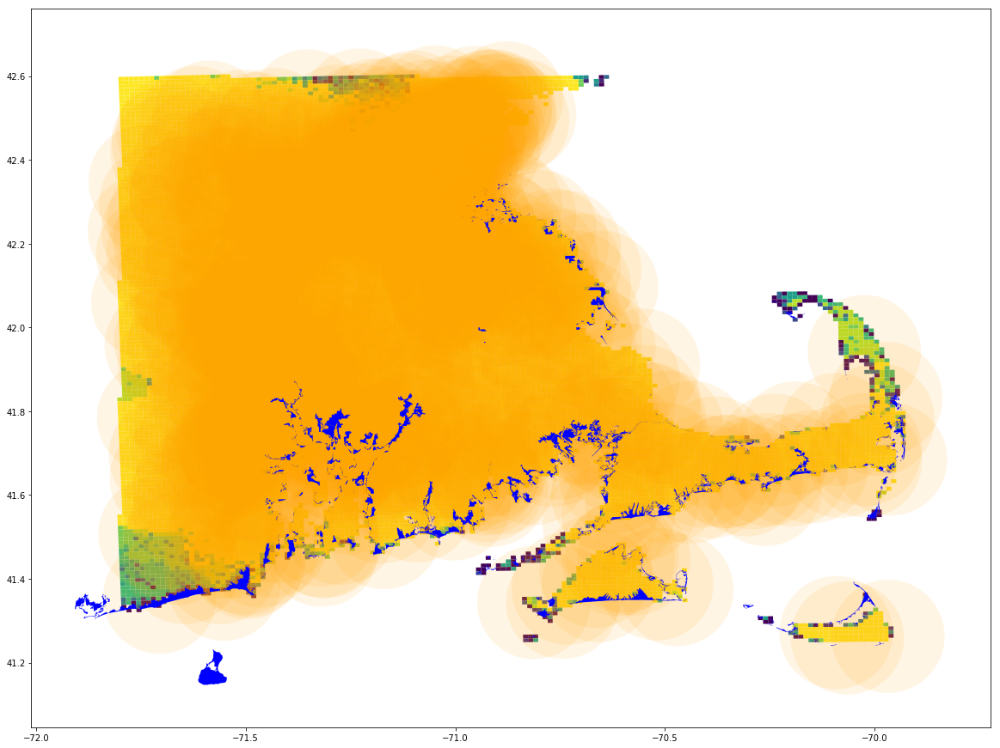

In [158]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
eff_stations.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='orange', ax=ax, zorder=5, alpha=0.1)

#Emergency Operations

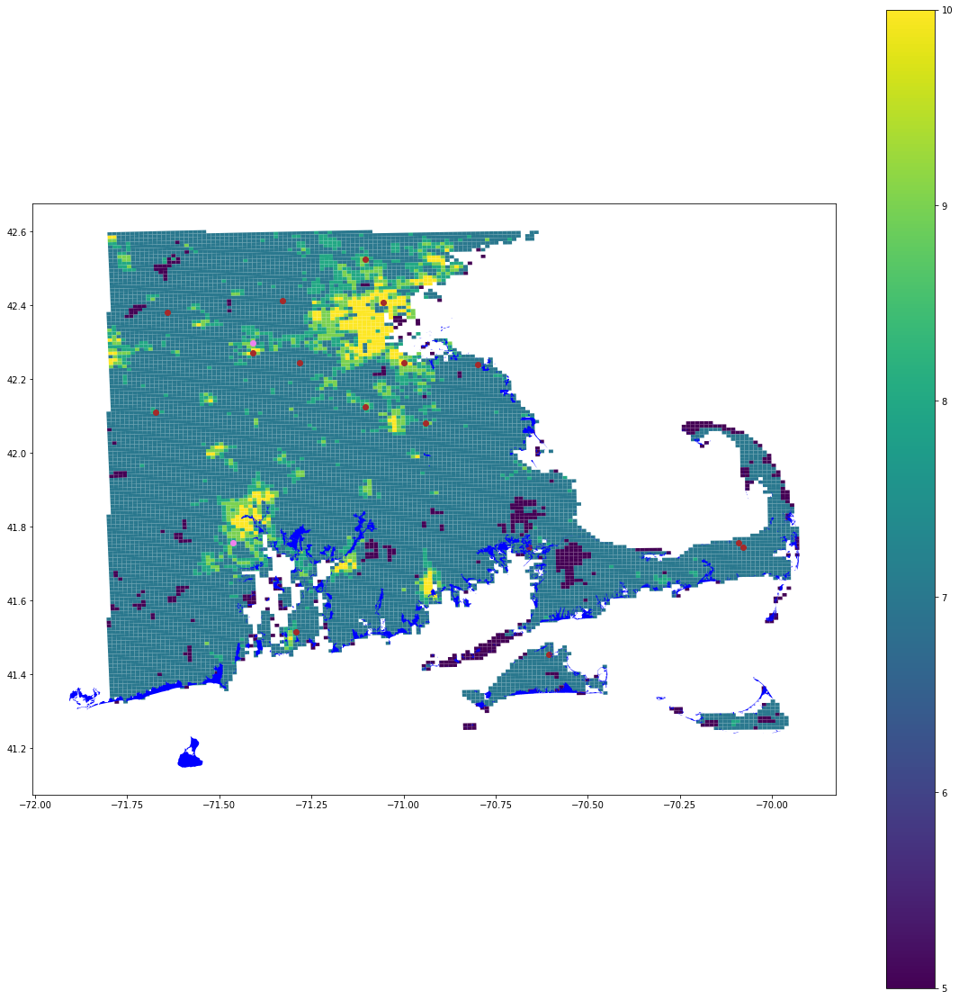

In [55]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
local_eo.to_crs(game_grid.crs).plot(color='brown', ax=ax, zorder=5)
state_eo.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

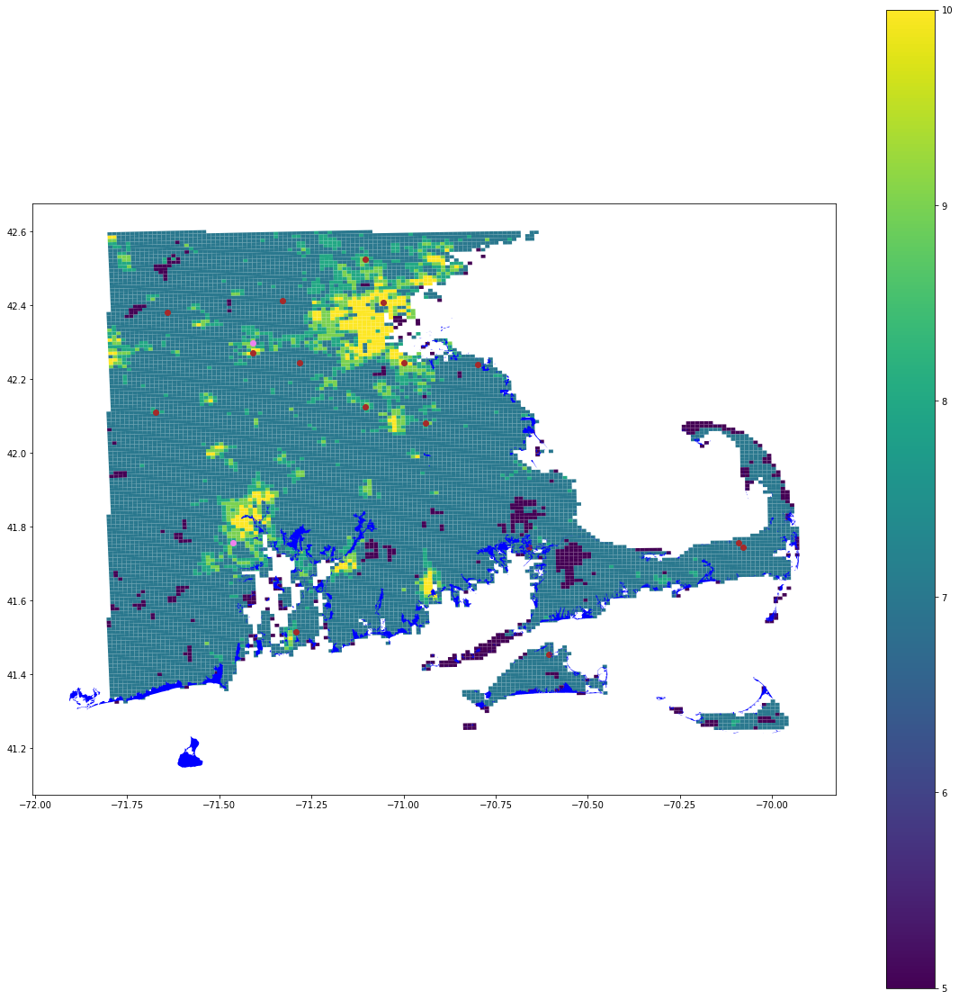

In [56]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
eff_lcl_eo.to_crs(game_grid.crs).plot(color='brown', ax=ax, zorder=5)
eff_stt_eo.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

/usr/local/lib/python3.6/dist-packages/geopandas/plotting.py:418: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  "empty. Nothing has been displayed.", UserWarning)


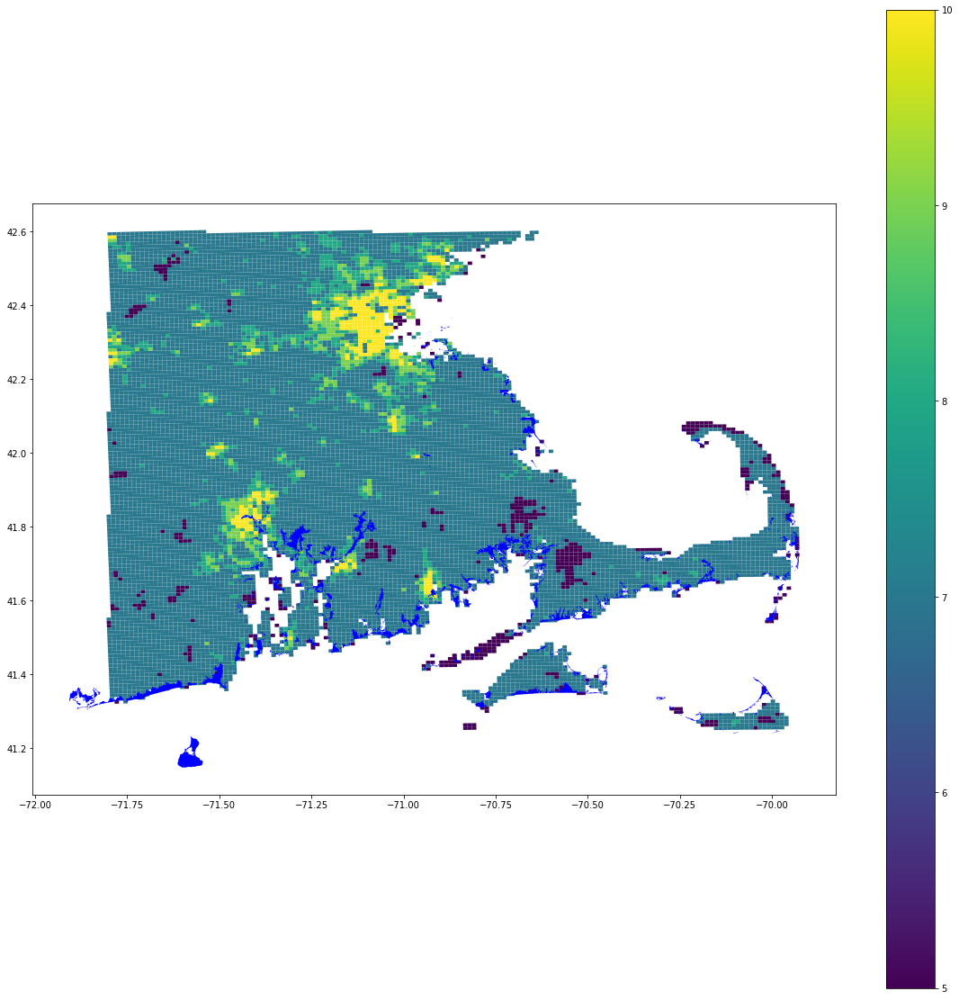

In [57]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
dead_lcl_eo.to_crs(game_grid.crs).plot(color='brown', ax=ax, zorder=5)
dead_stt_eo.to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5)

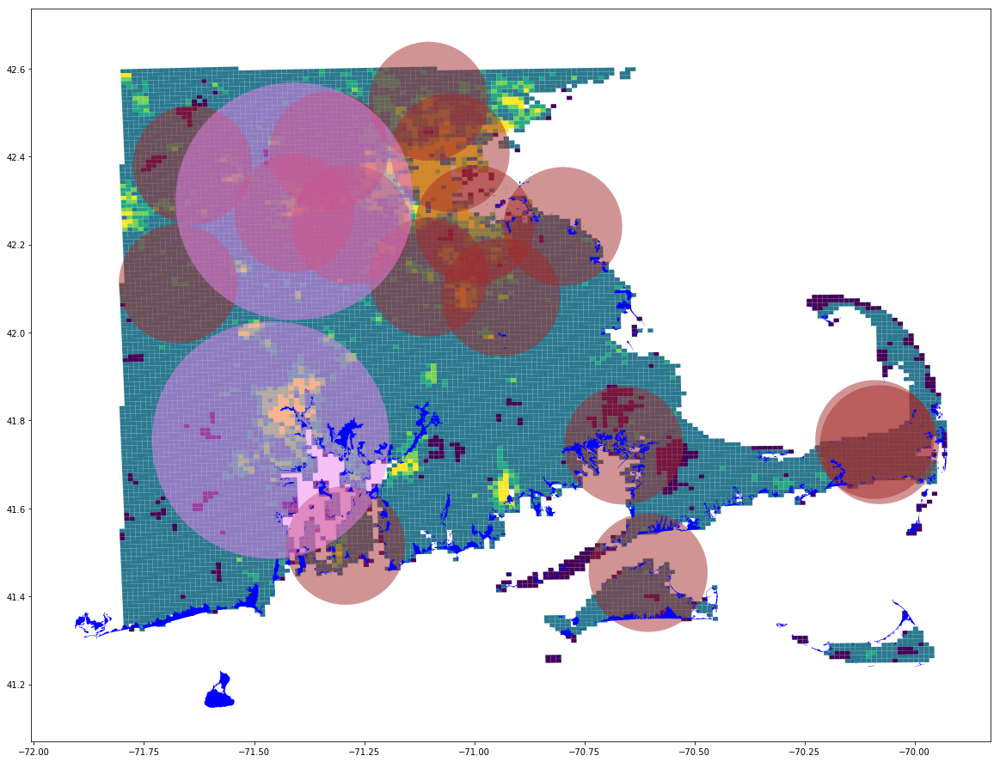

In [58]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
local_eo.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='brown', ax=ax, zorder=5, alpha=0.5)
state_eo.buffer(0.27027027027).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5, alpha=0.5)

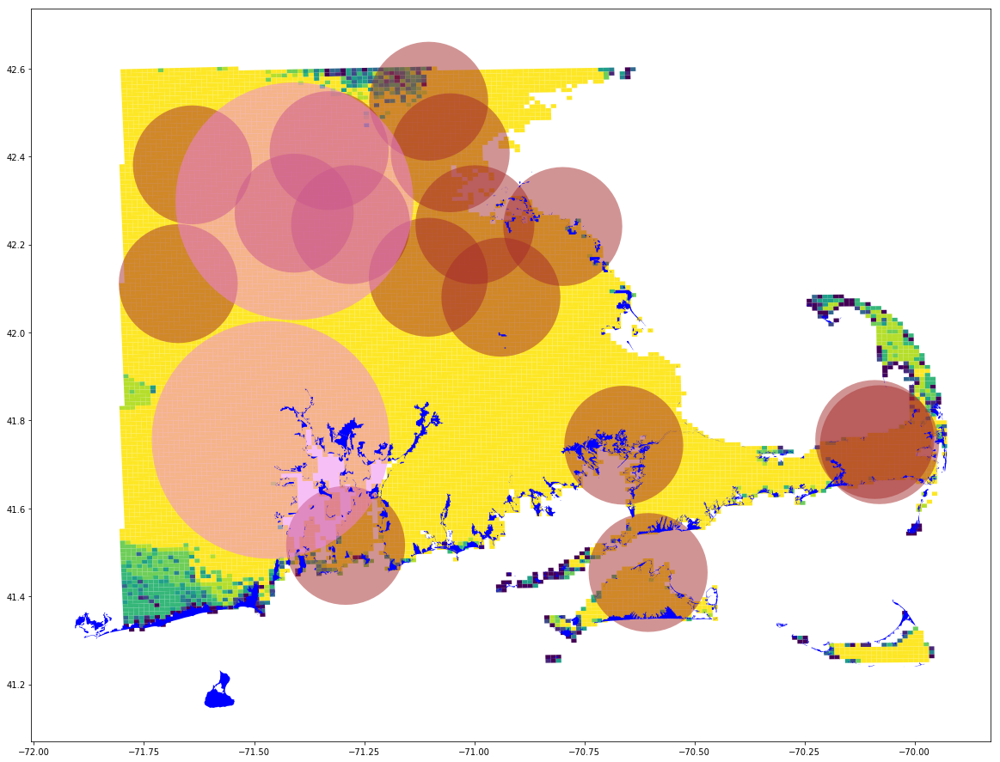

In [157]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Utility')
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax, zorder=10)
eff_lcl_eo.buffer(0.13513513513).to_crs(game_grid.crs).plot(color='brown', ax=ax, zorder=5, alpha=0.5)
eff_stt_eo.buffer(0.27027027027).to_crs(game_grid.crs).plot(color='violet', ax=ax, zorder=5, alpha=0.5)

#Transportation
This includes airfields

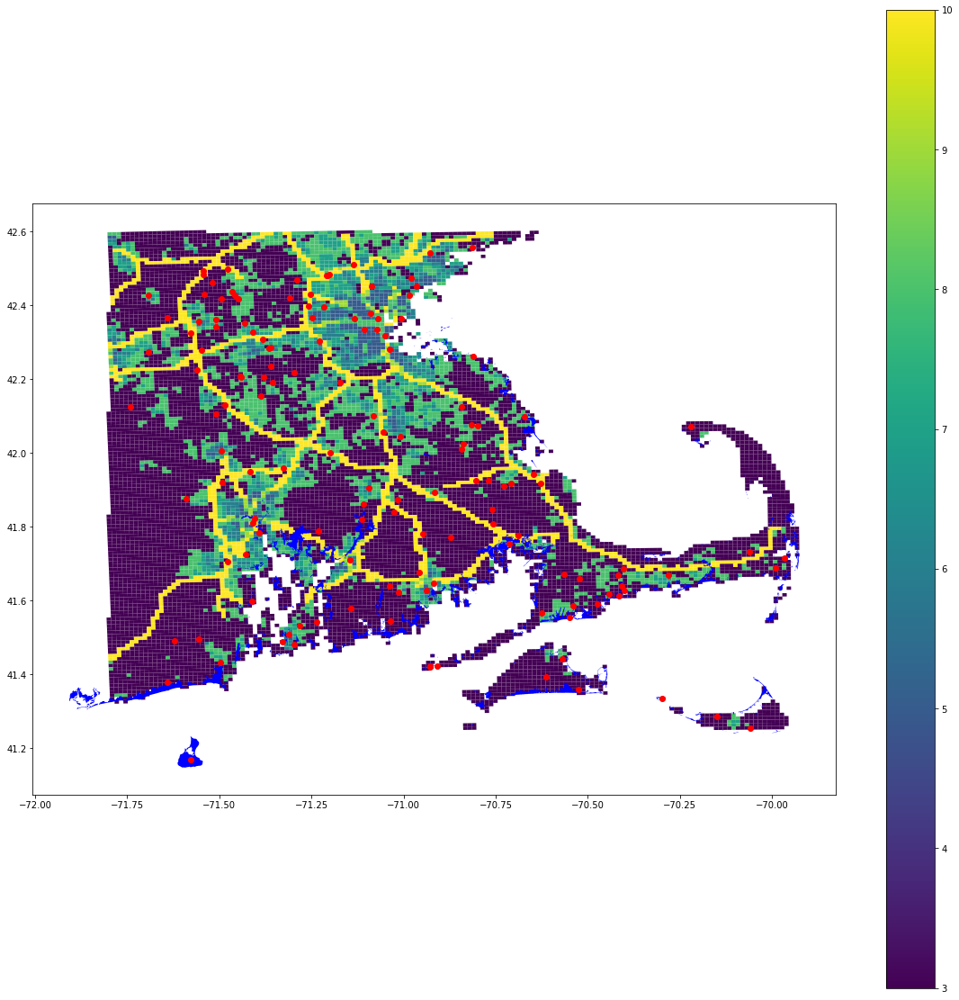

In [60]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Transporta', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)
airfields.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)

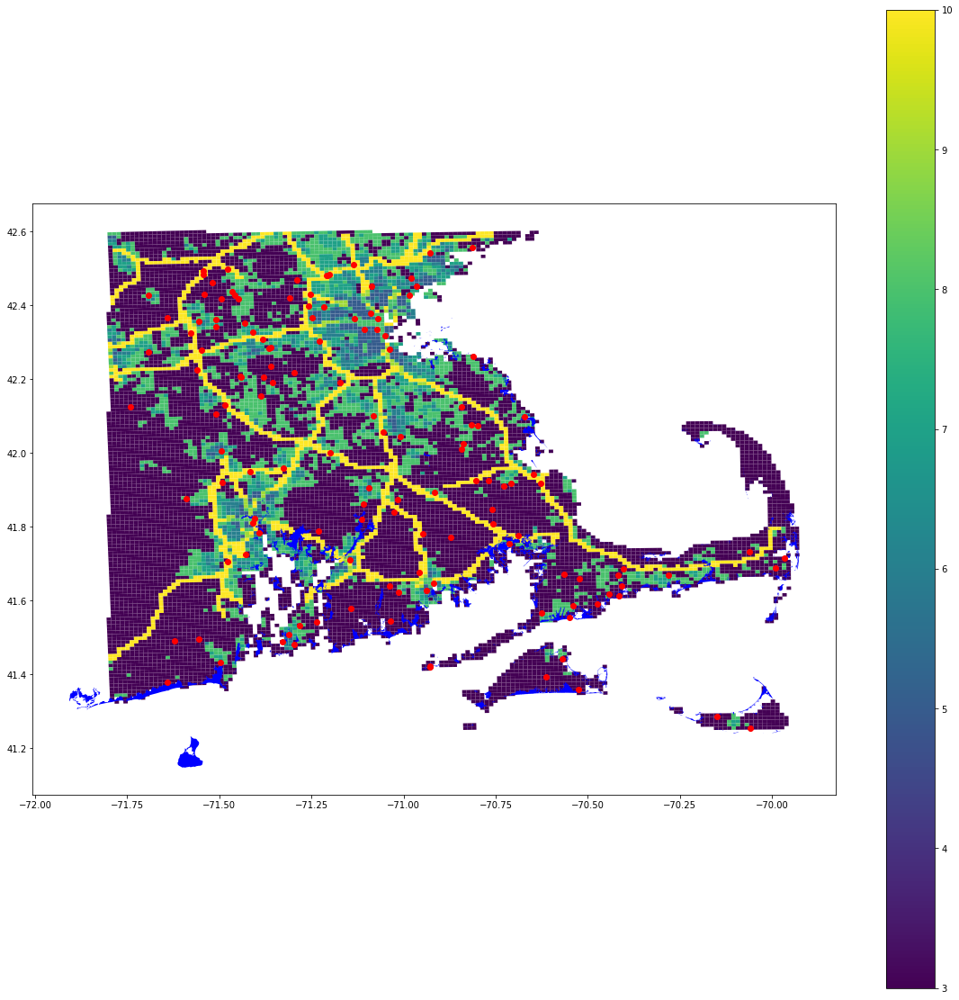

In [61]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Transporta', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)
eff_airfields.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)

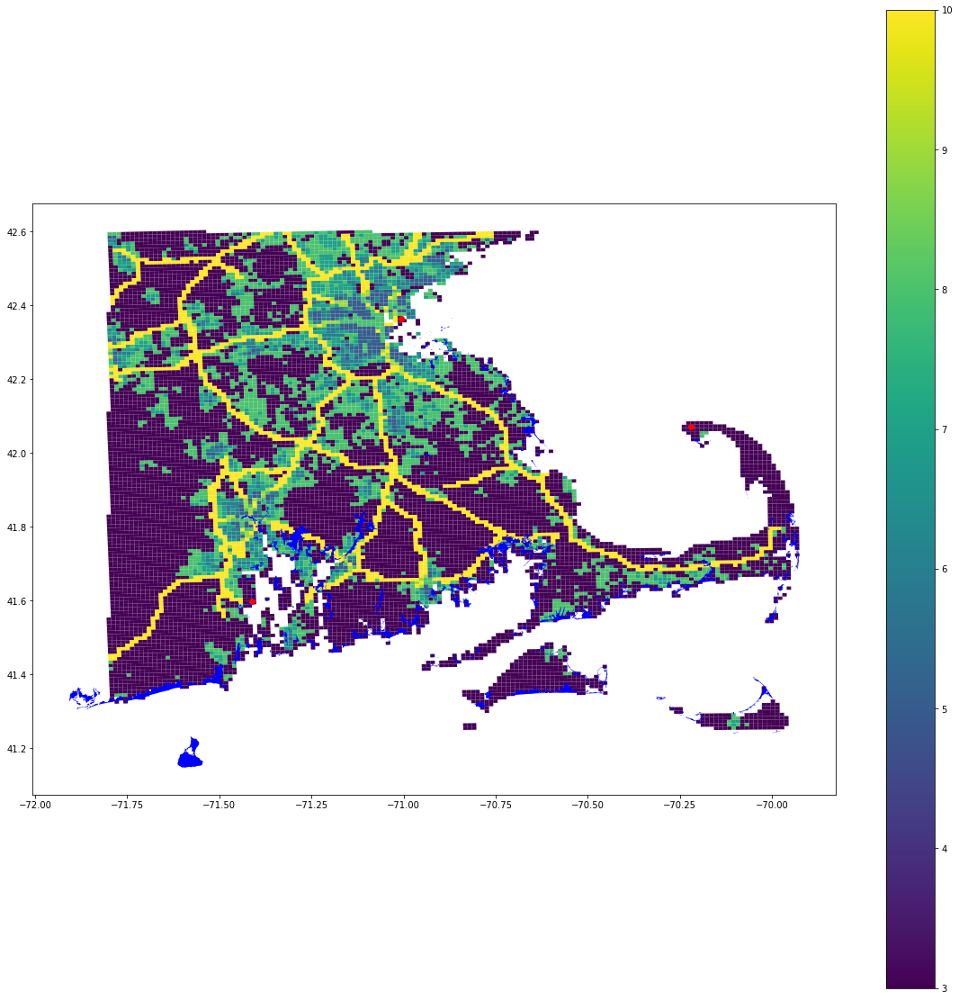

In [62]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
game_grid.plot(ax=ax, column='Transporta', legend=True)
flooding.to_crs(game_grid.crs).plot(color='blue', ax=ax)
dead_airfields.to_crs(game_grid.crs).plot(color='red', ax=ax, zorder=15)

#Changes in Map

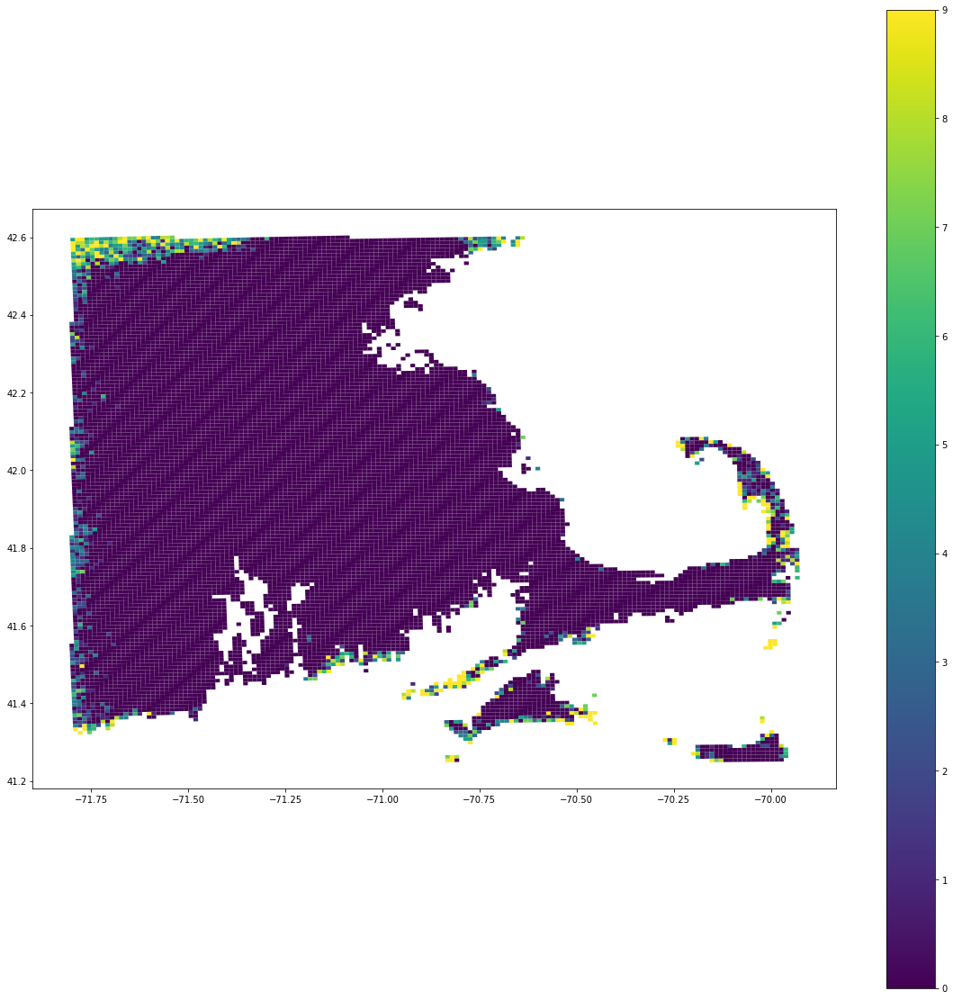

In [142]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
change.plot(ax=ax, column='Health', legend=True)

In [143]:
change.loc[change['Health']!=0]

,Health,Utility,Transporta,geometry
0,5,-3,3,POLYGON ((-71.79092278136125 42.58943590354409...
1,9,-3,4,POLYGON ((-71.77874932612048 42.58973201162303...
2,9,-3,7,POLYGON ((-71.76657568741803 42.59002682737616...
3,5,-3,2,POLYGON ((-71.75440186615322 42.59032035170287...
4,6,-3,2,POLYGON ((-71.74222786322531 42.59061258370377...
5,6,-3,2,POLYGON ((-71.73005367863436 42.59090352427819...
6,5,-3,2,POLYGON ((-71.71787931507833 42.59119317252686...
7,5,-1,2,POLYGON ((-71.70570477165785 42.59148152844978...
8,4,-3,2,POLYGON ((-71.69353005017166 42.59176859294621...
9,6,-3,2,POLYGON ((-71.68135515061971 42.59205436511684...


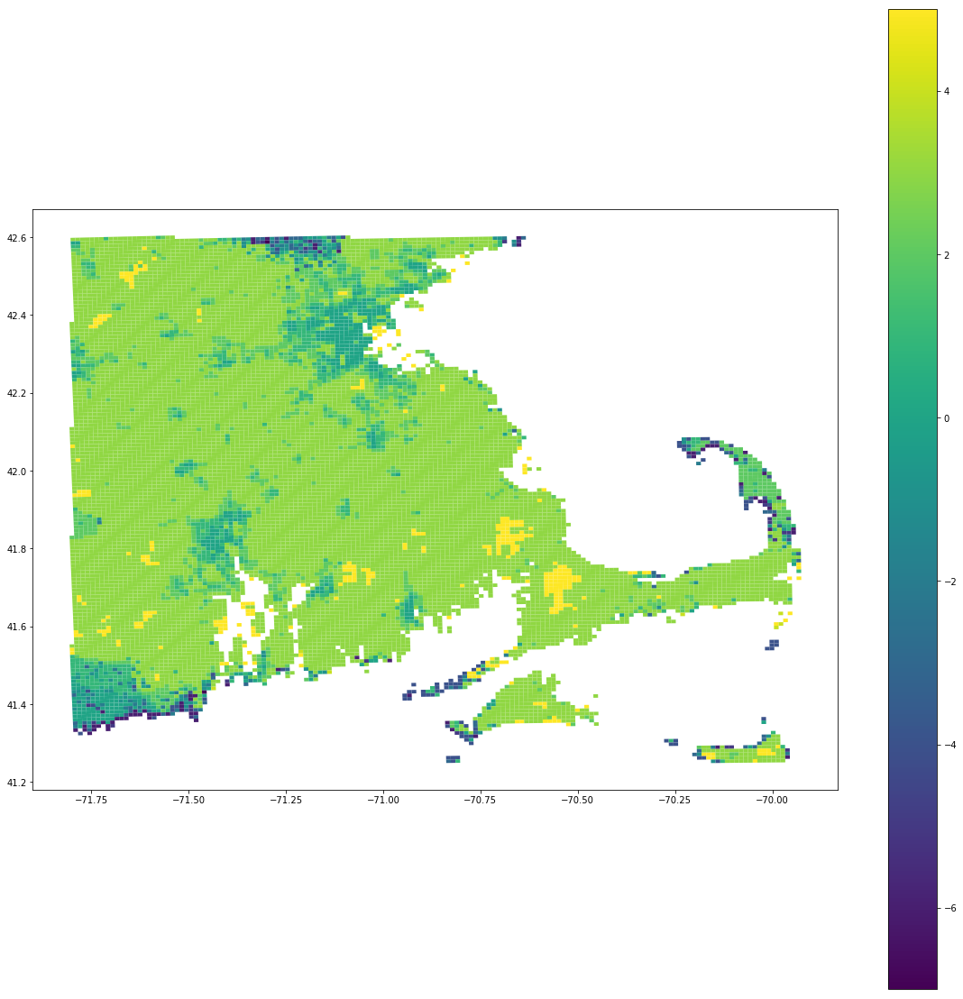

In [156]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
change.plot(ax=ax, column='Utility', legend=True)

In [155]:
change.loc[change['Utility']!=0]

,Health,Utility,Transporta,geometry
0,-5,3,-3,POLYGON ((-71.79092278136125 42.58943590354409...
1,-9,3,-4,POLYGON ((-71.77874932612048 42.58973201162303...
2,-9,3,-7,POLYGON ((-71.76657568741803 42.59002682737616...
3,-5,3,-2,POLYGON ((-71.75440186615322 42.59032035170287...
4,-6,3,-2,POLYGON ((-71.74222786322531 42.59061258370377...
5,-6,3,-2,POLYGON ((-71.73005367863436 42.59090352427819...
6,-5,3,-2,POLYGON ((-71.71787931507833 42.59119317252686...
7,-5,1,-2,POLYGON ((-71.70570477165785 42.59148152844978...
8,-4,3,-2,POLYGON ((-71.69353005017166 42.59176859294621...
9,-6,3,-2,POLYGON ((-71.68135515061971 42.59205436511684...


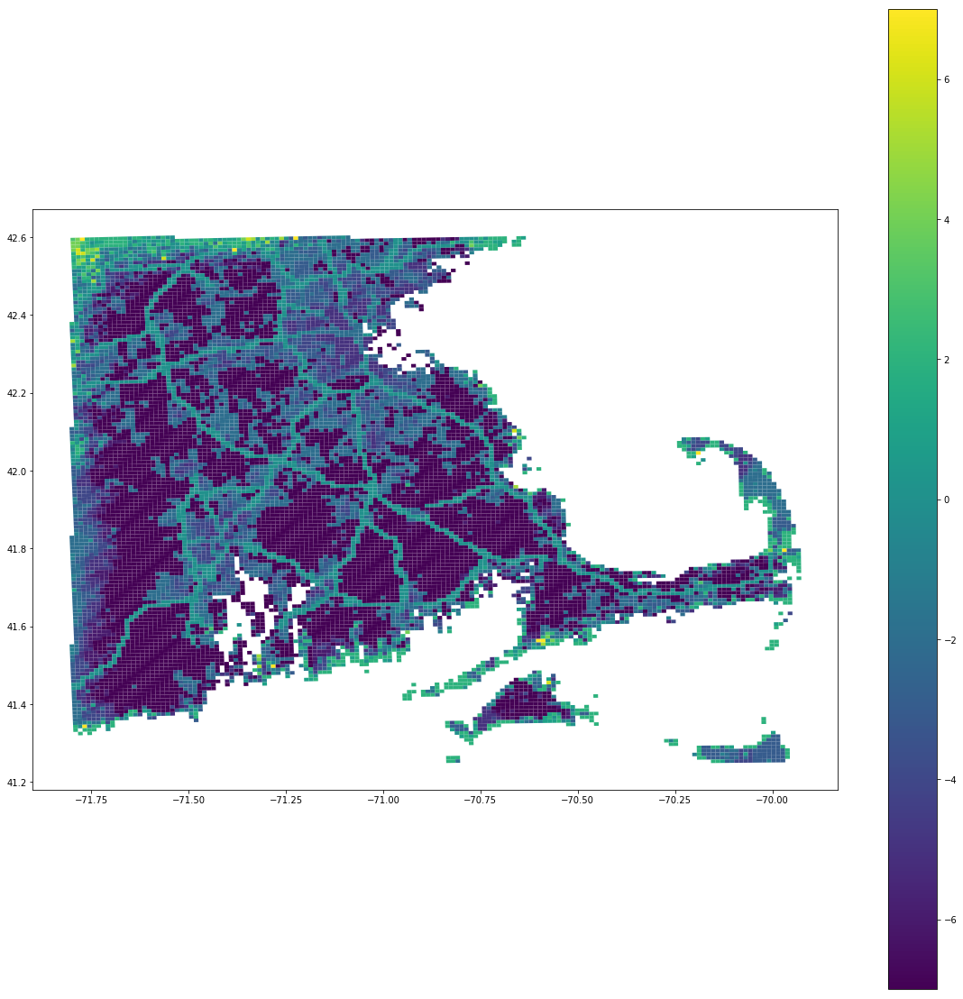

In [140]:
fig=plt.figure(figsize=[20,20])
ax=fig.add_subplot(1,1,1)
change.plot(ax=ax, column='Transporta', legend=True)

In [102]:
change.loc[change['Transporta']!=0]

,Health,Utility,Transporta,geometry


Health:

No one dies at 9-10

7-8 means each person has a .25% chance of dying per turn 

<7 means each person has a .5% chance of dying per turn

Utility:

Small Hospitals need >= 7

Big Hospitals need 9 or 10

Transportation:

10=100% movement speed,

9=90% movement speed

8=80% movement speed

and so on

We are almost gauranteed to have at least 3 days of prep time, and with average rolls, will have 4(3.5555555...)

With average rolls, we will have a catagory 2 hurricane.

Flooding and wind are proportional to the catagory of the hurricane.

Flooding drops all stats by an average of 3 and will not go further in a catagory 2 hurricane.

Wind drops the utility and transportation by 2(?) and drops health by 1, with 1 extra in highly-populated areas.

Wind is more likely to hit areas with greater utility or initial population